In [1]:
import pandas as pd 
import numpy as np 
import seaborn as sns
sns.set(color_codes=True)
import matplotlib.pyplot as plt
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.ensemble import StackingClassifier
from sklearn.impute import SimpleImputer
from sklearn import metrics
from sklearn.metrics import confusion_matrix

In [2]:
flight_data = pd.read_csv('Flight_data.csv')
survey_data = pd.read_csv('Survey_data.csv')

Unit of observation 

In [3]:
flight_data.shape  #Dataset is made up of 90917 obs and 9 variables
survey_data.shape  #Dataset is made up of 90917 obs and 16 variables

#length of data is the same as the other but different variables

(90917, 16)

In [8]:
flight_data.info()

# CustomerID, Age,Flight_Distance,DepartureDelayin_Mins are recorded as Integer, Arrivaldelayin_Mins is seen as float 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90917 entries, 0 to 90916
Data columns (total 9 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   CustomerID             90917 non-null  int64  
 1   Gender                 90917 non-null  object 
 2   CustomerType           81818 non-null  object 
 3   Age                    90917 non-null  int64  
 4   TypeTravel             81829 non-null  object 
 5   Class                  90917 non-null  object 
 6   Flight_Distance        90917 non-null  int64  
 7   DepartureDelayin_Mins  90917 non-null  int64  
 8   ArrivalDelayin_Mins    90633 non-null  float64
dtypes: float64(1), int64(4), object(4)
memory usage: 6.2+ MB


In [5]:
survey_data.info()
# CustomerId is the only Integer, 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90917 entries, 0 to 90916
Data columns (total 16 columns):
 #   Column                             Non-Null Count  Dtype 
---  ------                             --------------  ----- 
 0   CustomerId                         90917 non-null  int64 
 1   Satisfaction                       90917 non-null  object
 2   Seat_comfort                       90917 non-null  object
 3   Departure.Arrival.time_convenient  82673 non-null  object
 4   Food_drink                         82736 non-null  object
 5   Gate_location                      90917 non-null  object
 6   Inflightwifi_service               90917 non-null  object
 7   Inflight_entertainment             90917 non-null  object
 8   Online_support                     90917 non-null  object
 9   Ease_of_Onlinebooking              90917 non-null  object
 10  Onboard_service                    83738 non-null  object
 11  Leg_room_service                   90917 non-null  object
 12  Bagg

In [7]:
survey_data.head()

,CustomerID,Satisfaction,Seat_comfort,Departure.Arrival.time_convenient,Food_drink,Gate_location,Inflightwifi_service,Inflight_entertainment,Online_support,Ease_of_Onlinebooking,Onboard_service,Leg_room_service,Baggage_handling,Checkin_service,Cleanliness,Online_boarding
0,149965,satisfied,extremely poor,extremely poor,extremely poor,need improvement,need improvement,good,need improvement,acceptable,acceptable,extremely poor,acceptable,excellent,acceptable,need improvement
1,149966,satisfied,extremely poor,extremely poor,extremely poor,manageable,need improvement,extremely poor,need improvement,need improvement,NaN,acceptable,good,good,good,need improvement
2,149967,satisfied,extremely poor,NaN,extremely poor,manageable,acceptable,good,acceptable,poor,poor,extremely poor,poor,good,poor,acceptable
3,149968,satisfied,extremely poor,extremely poor,extremely poor,manageable,good,acceptable,good,need improvement,need improvement,extremely poor,need improvement,good,need improvement,excellent
4,149969,satisfied,extremely poor,extremely poor,extremely poor,manageable,need improvement,extremely poor,need improvement,need improvement,excellent,good,excellent,excellent,good,need improvement


In [7]:
flight_data.head()

,CustomerID,Gender,CustomerType,Age,TypeTravel,Class,Flight_Distance,DepartureDelayin_Mins,ArrivalDelayin_Mins
0,149965,Female,Loyal Customer,65,Personal Travel,Eco,265,0,0.0
1,149966,Female,Loyal Customer,15,Personal Travel,Eco,2138,0,0.0
2,149967,Female,Loyal Customer,60,Personal Travel,Eco,623,0,0.0
3,149968,Female,Loyal Customer,70,Personal Travel,Eco,354,0,0.0
4,149969,Male,Loyal Customer,30,NaN,Eco,1894,0,0.0


In [8]:
flight_data.columns

Index(['CustomerID', 'Gender', 'CustomerType', 'Age', 'TypeTravel', 'Class',
       'Flight_Distance', 'DepartureDelayin_Mins', 'ArrivalDelayin_Mins'],
      dtype='object')

In [3]:
survey_data = survey_data.rename(columns={'CustomerId':'CustomerID'})
#renaming the Customerid column in  survey data to CustomerID for an easy merge by=CustomerID

In [10]:
survey_data.columns
#to see if the column name changed 

Index(['CustomerID', 'Satisfaction', 'Seat_comfort',
       'Departure.Arrival.time_convenient', 'Food_drink', 'Gate_location',
       'Inflightwifi_service', 'Inflight_entertainment', 'Online_support',
       'Ease_of_Onlinebooking', 'Onboard_service', 'Leg_room_service',
       'Baggage_handling', 'Checkin_service', 'Cleanliness',
       'Online_boarding'],
      dtype='object')

In [4]:
#merge datasets as one dataset
airline_data = pd.merge(flight_data,survey_data)

In [12]:
airline_data.shape
#new data is now 90917 observations and 24 variables 

(90917, 24)

In [13]:
airline_data.columns

Index(['CustomerID', 'Gender', 'CustomerType', 'Age', 'TypeTravel', 'Class',
       'Flight_Distance', 'DepartureDelayin_Mins', 'ArrivalDelayin_Mins',
       'Satisfaction', 'Seat_comfort', 'Departure.Arrival.time_convenient',
       'Food_drink', 'Gate_location', 'Inflightwifi_service',
       'Inflight_entertainment', 'Online_support', 'Ease_of_Onlinebooking',
       'Onboard_service', 'Leg_room_service', 'Baggage_handling',
       'Checkin_service', 'Cleanliness', 'Online_boarding'],
      dtype='object')

In [8]:
airline_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 90917 entries, 0 to 90916
Data columns (total 24 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   CustomerID                         90917 non-null  int64  
 1   Gender                             90917 non-null  object 
 2   CustomerType                       81818 non-null  object 
 3   Age                                90917 non-null  int64  
 4   TypeTravel                         81829 non-null  object 
 5   Class                              90917 non-null  object 
 6   Flight_Distance                    90917 non-null  int64  
 7   DepartureDelayin_Mins              90917 non-null  int64  
 8   ArrivalDelayin_Mins                90633 non-null  float64
 9   Satisfaction                       90917 non-null  object 
 10  Seat_comfort                       90917 non-null  object 
 11  Departure.Arrival.time_convenient  82673 non-null  obj

In [5]:
#Changing from object to category 
airline_data["CustomerID"]=airline_data["CustomerID"].astype("category")
airline_data["Gender"]=airline_data["Gender"].astype("category")
airline_data["CustomerType"]=airline_data["CustomerType"].astype("category")
airline_data["TypeTravel"]=airline_data["TypeTravel"].astype("category")
airline_data["Class"]=airline_data["Class"].astype("category")
airline_data["Satisfaction"]=airline_data["Satisfaction"].astype("category")
airline_data["Seat_comfort"]=airline_data["Seat_comfort"].astype("category")
airline_data["Gate_location"]=airline_data["Gate_location"].astype("category")
airline_data["Food_drink"]=airline_data["Food_drink"].astype("category")
airline_data["Inflightwifi_service"]=airline_data["Inflightwifi_service"].astype("category")
airline_data["Inflight_entertainment"]=airline_data["Inflight_entertainment"].astype("category")
airline_data["Online_support"]=airline_data["Online_support"].astype("category")
airline_data["Ease_of_Onlinebooking"]=airline_data["Ease_of_Onlinebooking"].astype("category")
airline_data["Onboard_service"]=airline_data["Onboard_service"].astype("category")
airline_data["Leg_room_service"]=airline_data["Leg_room_service"].astype("category")
airline_data["Baggage_handling"]=airline_data["Baggage_handling"].astype("category")
airline_data["Checkin_service"]=airline_data["Checkin_service"].astype("category")
airline_data["Cleanliness"]=airline_data["Cleanliness"].astype("category")
airline_data["Online_boarding"]=airline_data["Online_boarding"].astype("category")
airline_data["Departure.Arrival.time_convenient"]=airline_data["Departure.Arrival.time_convenient"].astype("category")

In [15]:
airline_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 90917 entries, 0 to 90916
Data columns (total 24 columns):
 #   Column                             Non-Null Count  Dtype   
---  ------                             --------------  -----   
 0   CustomerID                         90917 non-null  category
 1   Gender                             90917 non-null  category
 2   CustomerType                       81818 non-null  category
 3   Age                                90917 non-null  int64   
 4   TypeTravel                         81829 non-null  category
 5   Class                              90917 non-null  category
 6   Flight_Distance                    90917 non-null  int64   
 7   DepartureDelayin_Mins              90917 non-null  int64   
 8   ArrivalDelayin_Mins                90633 non-null  float64 
 9   Satisfaction                       90917 non-null  category
 10  Seat_comfort                       90917 non-null  category
 11  Departure.Arrival.time_convenient  82673 

In [19]:
airline_data.head()

,CustomerID,Gender,CustomerType,Age,TypeTravel,Class,Flight_Distance,DepartureDelayin_Mins,ArrivalDelayin_Mins,Satisfaction,...,Inflightwifi_service,Inflight_entertainment,Online_support,Ease_of_Onlinebooking,Onboard_service,Leg_room_service,Baggage_handling,Checkin_service,Cleanliness,Online_boarding
0,149965,Female,Loyal Customer,65,Personal Travel,1,265,0,0.0,satisfied,...,need improvement,good,need improvement,acceptable,acceptable,extremely poor,acceptable,excellent,acceptable,need improvement
1,149966,Female,Loyal Customer,15,Personal Travel,1,2138,0,0.0,satisfied,...,need improvement,extremely poor,need improvement,need improvement,NaN,acceptable,good,good,good,need improvement
2,149967,Female,Loyal Customer,60,Personal Travel,1,623,0,0.0,satisfied,...,acceptable,good,acceptable,poor,poor,extremely poor,poor,good,poor,acceptable
3,149968,Female,Loyal Customer,70,Personal Travel,1,354,0,0.0,satisfied,...,good,acceptable,good,need improvement,need improvement,extremely poor,need improvement,good,need improvement,excellent
4,149969,Male,Loyal Customer,30,NaN,1,1894,0,0.0,satisfied,...,need improvement,extremely poor,need improvement,need improvement,excellent,good,excellent,excellent,good,need improvement


In [10]:
# looking at value counts for non-numeric features

num_to_display = 10  # defining this up here so it's easy to change later if I want
for colname in airline_data.dtypes[airline_data.dtypes == 'category'].index:
    val_counts = airline_data[colname].value_counts(dropna=False)  # i want to see NA counts
    print(val_counts[:num_to_display])
    if len(val_counts) > num_to_display:
        print(f'Only displaying first {num_to_display} of {len(val_counts)} values.')
    print('\n\n') # just for more space between 

240881    1
180240    1
180264    1
180265    1
180266    1
180267    1
180268    1
180269    1
180270    1
180271    1
Name: CustomerID, dtype: int64
Only displaying first 10 of 90917 values.



Female    46186
Male      44731
Name: Gender, dtype: int64



Loyal Customer       66897
disloyal Customer    14921
NaN                   9099
Name: CustomerType, dtype: int64



Business travel    56481
Personal Travel    25348
NaN                 9088
Name: TypeTravel, dtype: int64



Business    43535
Eco         40758
Eco Plus     6624
Name: Class, dtype: int64



satisfied                  49761
neutral or dissatisfied    41156
Name: Satisfaction, dtype: int64



acceptable          20552
need improvement    20002
good                19789
poor                14687
excellent           12519
extremely poor       3368
Name: Seat_comfort, dtype: int64



good                18840
excellent           17079
acceptable          14806
need improvement    14539
poor                13210
NaN      

Relevel the categorical variables without missing values to reduce the columns of dummy variables 

In [6]:
#Class
from sklearn.preprocessing import LabelEncoder
number = LabelEncoder()
airline_data['Class']= number.fit_transform(airline_data['Class'].astype('str'))
airline_data.Class.unique() 

array([1, 0, 2])

In [7]:
#Seat_comfort
from sklearn.preprocessing import LabelEncoder
number = LabelEncoder()
airline_data['Seat_comfort']= number.fit_transform(airline_data['Seat_comfort'].astype('str'))
airline_data.Seat_comfort.unique() 

array([2, 5, 3, 1, 4, 0])

In [8]:
from sklearn.preprocessing import LabelEncoder
number = LabelEncoder()
airline_data['Gate_location']= number.fit_transform(airline_data['Gate_location'].astype('str'))
airline_data.Gate_location.unique() 

array([3, 2, 0, 1, 4, 5])

In [9]:
from sklearn.preprocessing import LabelEncoder
number = LabelEncoder()
airline_data['Inflightwifi_service']= number.fit_transform(airline_data['Inflightwifi_service'].astype('str'))
airline_data.Inflightwifi_service.unique() 

array([4, 0, 3, 1, 5, 2])

In [10]:
from sklearn.preprocessing import LabelEncoder
number = LabelEncoder()
airline_data['Inflight_entertainment']= number.fit_transform(airline_data['Inflight_entertainment'].astype('str'))
airline_data.Inflight_entertainment.unique() 

array([3, 2, 0, 1, 4, 5])

In [11]:
from sklearn.preprocessing import LabelEncoder
number = LabelEncoder()
airline_data['Online_support']= number.fit_transform(airline_data['Online_support'].astype('str'))
airline_data.Online_support.unique() 

array([4, 0, 3, 1, 5, 2])

In [12]:
from sklearn.preprocessing import LabelEncoder
number = LabelEncoder()
airline_data['Ease_of_Onlinebooking']= number.fit_transform(airline_data['Ease_of_Onlinebooking'].astype('str'))
airline_data.Ease_of_Onlinebooking.unique()

array([0, 4, 5, 1, 3, 2])

In [13]:
from sklearn.preprocessing import LabelEncoder
number = LabelEncoder()
airline_data['Leg_room_service']= number.fit_transform(airline_data['Leg_room_service'].astype('str'))
airline_data.Leg_room_service.unique() 

array([2, 0, 3, 4, 5, 1])

In [14]:
from sklearn.preprocessing import LabelEncoder
number = LabelEncoder()
airline_data['Baggage_handling']= number.fit_transform(airline_data['Baggage_handling'].astype('str'))
airline_data.Baggage_handling.unique() 

array([0, 2, 4, 3, 1])

In [15]:
from sklearn.preprocessing import LabelEncoder
number = LabelEncoder()
airline_data['Checkin_service']= number.fit_transform(airline_data['Checkin_service'].astype('str'))
airline_data.Checkin_service.unique()

array([1, 3, 0, 4, 5, 2])

In [16]:
from sklearn.preprocessing import LabelEncoder
number = LabelEncoder()
airline_data['Cleanliness']= number.fit_transform(airline_data['Cleanliness'].astype('str'))
airline_data.Cleanliness.unique()

array([0, 3, 5, 4, 1, 2])

In [17]:
from sklearn.preprocessing import LabelEncoder
number = LabelEncoder()
airline_data['Online_boarding']= number.fit_transform(airline_data['Online_boarding'].astype('str'))
airline_data.Online_boarding.unique()

array([4, 0, 1, 5, 3, 2])

In [18]:
from sklearn.preprocessing import LabelEncoder
number = LabelEncoder()
airline_data['Gender']= number.fit_transform(airline_data['Gender'].astype('str'))
airline_data.Gender.unique()

array([0, 1])

In [19]:
airline_data.head()

,CustomerID,Gender,CustomerType,Age,TypeTravel,Class,Flight_Distance,DepartureDelayin_Mins,ArrivalDelayin_Mins,Satisfaction,...,Inflightwifi_service,Inflight_entertainment,Online_support,Ease_of_Onlinebooking,Onboard_service,Leg_room_service,Baggage_handling,Checkin_service,Cleanliness,Online_boarding
0,149965,0,Loyal Customer,65,Personal Travel,1,265,0,0.0,satisfied,...,4,3,4,0,acceptable,2,0,1,0,4
1,149966,0,Loyal Customer,15,Personal Travel,1,2138,0,0.0,satisfied,...,4,2,4,4,NaN,0,2,3,3,4
2,149967,0,Loyal Customer,60,Personal Travel,1,623,0,0.0,satisfied,...,0,3,0,5,poor,2,4,3,5,0
3,149968,0,Loyal Customer,70,Personal Travel,1,354,0,0.0,satisfied,...,3,0,3,4,need improvement,2,3,3,4,1
4,149969,1,Loyal Customer,30,NaN,1,1894,0,0.0,satisfied,...,4,2,4,4,excellent,3,1,1,3,4


In [19]:
airline_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 90917 entries, 0 to 90916
Data columns (total 24 columns):
 #   Column                             Non-Null Count  Dtype   
---  ------                             --------------  -----   
 0   CustomerID                         90917 non-null  category
 1   Gender                             90917 non-null  int32   
 2   CustomerType                       81818 non-null  category
 3   Age                                90917 non-null  int64   
 4   TypeTravel                         81829 non-null  category
 5   Class                              90917 non-null  int32   
 6   Flight_Distance                    90917 non-null  int64   
 7   DepartureDelayin_Mins              90917 non-null  int64   
 8   ArrivalDelayin_Mins                90633 non-null  float64 
 9   Satisfaction                       90917 non-null  category
 10  Seat_comfort                       90917 non-null  int32   
 11  Departure.Arrival.time_convenient  82673 

In [19]:
#Changing from object to category 
airline_data["CustomerID"]=airline_data["CustomerID"].astype("category")
airline_data["Gender"]=airline_data["Gender"].astype("category")
airline_data["CustomerType"]=airline_data["CustomerType"].astype("category")
airline_data["TypeTravel"]=airline_data["TypeTravel"].astype("category")
airline_data["Class"]=airline_data["Class"].astype("category")
airline_data["Satisfaction"]=airline_data["Satisfaction"].astype("category")
airline_data["Seat_comfort"]=airline_data["Seat_comfort"].astype("category")
airline_data["Gate_location"]=airline_data["Gate_location"].astype("category")
airline_data["Food_drink"]=airline_data["Food_drink"].astype("category")
airline_data["Inflightwifi_service"]=airline_data["Inflightwifi_service"].astype("category")
airline_data["Inflight_entertainment"]=airline_data["Inflight_entertainment"].astype("category")
airline_data["Online_support"]=airline_data["Online_support"].astype("category")
airline_data["Ease_of_Onlinebooking"]=airline_data["Ease_of_Onlinebooking"].astype("category")
airline_data["Onboard_service"]=airline_data["Onboard_service"].astype("category")
airline_data["Leg_room_service"]=airline_data["Leg_room_service"].astype("category")
airline_data["Baggage_handling"]=airline_data["Baggage_handling"].astype("category")
airline_data["Checkin_service"]=airline_data["Checkin_service"].astype("category")
airline_data["Cleanliness"]=airline_data["Cleanliness"].astype("category")
airline_data["Online_boarding"]=airline_data["Online_boarding"].astype("category")
airline_data["Departure.Arrival.time_convenient"]=airline_data["Departure.Arrival.time_convenient"].astype("category")

In [27]:
# looking at value counts for releveled categories 

num_to_display = 10  # defining this up here so it's easy to change later if I want
for colname in airline_data.dtypes[airline_data.dtypes == 'category'].index:
    val_counts = airline_data[colname].value_counts(dropna=False)  # i want to see NA counts
    print(val_counts[:num_to_display])
    if len(val_counts) > num_to_display:
        print(f'Only displaying first {num_to_display} of {len(val_counts)} values.')
    print('\n\n') # just for more space between 

240881    1
180240    1
180264    1
180265    1
180266    1
180267    1
180268    1
180269    1
180270    1
180271    1
Name: CustomerID, dtype: int64
Only displaying first 10 of 90917 values.



0    46186
1    44731
Name: Gender, dtype: int64



Loyal Customer       66897
disloyal Customer    14921
NaN                   9099
Name: CustomerType, dtype: int64



Business travel    56481
Personal Travel    25348
NaN                 9088
Name: TypeTravel, dtype: int64



0    43535
1    40758
2     6624
Name: Class, dtype: int64



satisfied                  49761
neutral or dissatisfied    41156
Name: Satisfaction, dtype: int64



0    20552
4    20002
3    19789
5    14687
1    12519
2     3368
Name: Seat_comfort, dtype: int64



good                18840
excellent           17079
acceptable          14806
need improvement    14539
poor                13210
NaN                  8244
extremely poor       4199
Name: Departure.Arrival.time_convenient, dtype: int64



acceptable          1

In [25]:
airline_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 90917 entries, 0 to 90916
Data columns (total 24 columns):
 #   Column                             Non-Null Count  Dtype   
---  ------                             --------------  -----   
 0   CustomerID                         90917 non-null  category
 1   Gender                             90917 non-null  int32   
 2   CustomerType                       81818 non-null  category
 3   Age                                90917 non-null  int64   
 4   TypeTravel                         81829 non-null  category
 5   Class                              90917 non-null  int32   
 6   Flight_Distance                    90917 non-null  int64   
 7   DepartureDelayin_Mins              90917 non-null  int64   
 8   ArrivalDelayin_Mins                90633 non-null  float64 
 9   Satisfaction                       90917 non-null  category
 10  Seat_comfort                       90917 non-null  int32   
 11  Departure.Arrival.time_convenient  82673 

In [20]:
import pandas_profiling
airline_data.profile_report()

Summarize dataset:   0%|          | 0/37 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [38]:
airline_data.describe()

,Age,Flight_Distance,DepartureDelayin_Mins,ArrivalDelayin_Mins
count,90917.000000,90917.000000,90917.000000,90633.000000
mean,39.447166,1981.629442,14.686593,15.058930
std,15.129794,1026.779932,38.669260,39.038523
min,7.000000,50.000000,0.000000,0.000000
25%,27.000000,1360.000000,0.000000,0.000000
50%,40.000000,1927.000000,0.000000,0.000000
75%,51.000000,2542.000000,12.000000,13.000000
max,85.000000,6950.000000,1592.000000,1584.000000


In [39]:
airline_data.describe(include=["category"])

,CustomerID,Gender,CustomerType,TypeTravel,Class,Satisfaction,Seat_comfort,Departure.Arrival.time_convenient,Food_drink,Gate_location,Inflightwifi_service,Inflight_entertainment,Online_support,Ease_of_Onlinebooking,Onboard_service,Leg_room_service,Baggage_handling,Checkin_service,Cleanliness,Online_boarding
count,90917,90917,81818,81829,90917,90917,90917,82673,82736,90917,90917,90917,90917,90917,83738,90917,90917,90917,90917,90917
unique,90917,2,2,2,3,2,6,6,6,6,6,6,6,6,6,6,5,6,6,6
top,240881,0,Loyal Customer,Business travel,0,satisfied,0,good,acceptable,2,3,3,3,3,good,3,2,3,3,3
freq,1,46186,66897,56481,43535,49761,20552,18840,17991,23385,22159,29373,29042,27993,26373,27814,33822,25483,34246,24676


In [29]:
airline_data.isnull().sum()

CustomerID                              0
Gender                                  0
CustomerType                         9099
Age                                     0
TypeTravel                           9088
Class                                   0
Flight_Distance                         0
DepartureDelayin_Mins                   0
ArrivalDelayin_Mins                   284
Satisfaction                            0
Seat_comfort                            0
Departure.Arrival.time_convenient    8244
Food_drink                           8181
Gate_location                           0
Inflightwifi_service                    0
Inflight_entertainment                  0
Online_support                          0
Ease_of_Onlinebooking                   0
Onboard_service                      7179
Leg_room_service                        0
Baggage_handling                        0
Checkin_service                         0
Cleanliness                             0
Online_boarding                   

In [41]:
dupes = airline_data.duplicated()
sum(dupes)
#there are no duplicates in the dataset 

0

In [32]:
airline_data.isnull().sum()/len(airline_data)
#to see a percentage missing values 
#missing values of customer type is 10% of the dataset,while the other variable are less than 1% of the dataset

CustomerID                           0.000000
Gender                               0.000000
CustomerType                         0.100080
Age                                  0.000000
TypeTravel                           0.099959
Class                                0.000000
Flight_Distance                      0.000000
DepartureDelayin_Mins                0.000000
ArrivalDelayin_Mins                  0.003124
Satisfaction                         0.000000
Seat_comfort                         0.000000
Departure.Arrival.time_convenient    0.090676
Food_drink                           0.089983
Gate_location                        0.000000
Inflightwifi_service                 0.000000
Inflight_entertainment               0.000000
Online_support                       0.000000
Ease_of_Onlinebooking                0.000000
Onboard_service                      0.078962
Leg_room_service                     0.000000
Baggage_handling                     0.000000
Checkin_service                   

In [20]:
#changing categorical variables to dummy variable
falcon= pd.get_dummies(airline_data, columns=['Satisfaction','CustomerType','TypeTravel','Departure.Arrival.time_convenient', 'Food_drink', 'Onboard_service'], drop_first=True)

In [31]:
falcon.head()

,CustomerID,Gender,Age,Class,Flight_Distance,DepartureDelayin_Mins,ArrivalDelayin_Mins,Seat_comfort,Gate_location,Inflightwifi_service,...,Food_drink_excellent,Food_drink_extremely poor,Food_drink_good,Food_drink_need improvement,Food_drink_poor,Onboard_service_excellent,Onboard_service_extremely poor,Onboard_service_good,Onboard_service_need improvement,Onboard_service_poor
0,149965,0,65,1,265,0,0.0,2,3,4,...,0,1,0,0,0,0,0,0,0,0
1,149966,0,15,1,2138,0,0.0,2,2,4,...,0,1,0,0,0,0,0,0,0,0
2,149967,0,60,1,623,0,0.0,2,2,0,...,0,1,0,0,0,0,0,0,0,1
3,149968,0,70,1,354,0,0.0,2,2,3,...,0,1,0,0,0,0,0,0,1,0
4,149969,1,30,1,1894,0,0.0,2,2,4,...,0,1,0,0,0,1,0,0,0,0


In [21]:
falcon.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 90917 entries, 0 to 90916
Data columns (total 36 columns):
 #   Column                                              Non-Null Count  Dtype   
---  ------                                              --------------  -----   
 0   CustomerID                                          90917 non-null  category
 1   Gender                                              90917 non-null  int32   
 2   Age                                                 90917 non-null  int64   
 3   Class                                               90917 non-null  int32   
 4   Flight_Distance                                     90917 non-null  int64   
 5   DepartureDelayin_Mins                               90917 non-null  int64   
 6   ArrivalDelayin_Mins                                 90633 non-null  float64 
 7   Seat_comfort                                        90917 non-null  int32   
 8   Gate_location                                       90917 non-null

In [25]:
#using information value to see variables that do not contribute to prediction 
#creating a function that finds information value 
def iv_woe(data,target, bins=10, show_woe=False):
    
    #Empty Dataframe
    newDF,woeDF = pd.DataFrame(), pd.DataFrame()
    
    #Extract Column Names
    cols = data.columns
    
    #Run WOE and IV on all the independent variables
    for ivars in cols[~cols.isin([target])]:
        if (data[ivars].dtype.kind in 'bifc') and (len(np.unique(data[ivars]))>10):
            binned_x = pd.qcut(data[ivars], 10,  duplicates='drop')
            d0 = pd.DataFrame({'x': binned_x, 'y':data [target]})
        else:
            d0 = pd.DataFrame({'x':data[ivars], 'y': data[target]})
        d = d0.groupby("x", as_index=False).agg({"y": ["count", "sum"]})
        d.columns = ['Cutoff', 'N', 'Events']
        d['% of Events'] = np.maximum(d['Events'], 0.5) / d['Events'].sum()
        d['Non-Events'] = d['N'] - d['Events']
        d['% of Non-Events'] = np.maximum(d['Non-Events'], 0.5) / d['Non-Events'].sum()
        d['WoE'] = np.log(d['% of Events']/d['% of Non-Events'])
        d['IV'] = d['WoE'] * (d['% of Events'] - d['% of Non-Events'])
        d.insert(loc=0, column='Variable', value=ivars)
        print("Information value of " + ivars + " is " + str(round(d['IV'].sum(),6)))
        temp =pd.DataFrame({"Variable" : [ivars], "IV" : [d['IV'].sum()]}, columns = ["Variable", "IV"])
        newDF=pd.concat([newDF,temp], axis=0)
        woeDF=pd.concat([woeDF,d], axis=0)

        #Show WOE Table
        if show_woe == True:
            print(d)
    return newDF, woeDF

In [26]:
#print information value 
iv2, woe2 = iv_woe(data = falcon, target = 'Satisfaction_satisfied', bins=10, show_woe = True)
print(iv2)

Information value of CustomerID is 0.716881
         Variable  Cutoff  N  Events  % of Events  Non-Events  \
0      CustomerID  149965  1       1      0.00002           0   
1      CustomerID  149966  1       1      0.00002           0   
2      CustomerID  149967  1       1      0.00002           0   
3      CustomerID  149968  1       1      0.00002           0   
4      CustomerID  149969  1       1      0.00002           0   
...           ...     ... ..     ...          ...         ...   
90912  CustomerID  240877  1       1      0.00002           0   
90913  CustomerID  240878  1       1      0.00002           0   
90914  CustomerID  240879  1       0      0.00001           1   
90915  CustomerID  240880  1       0      0.00001           1   
90916  CustomerID  240881  1       0      0.00001           1   

       % of Non-Events       WoE        IV  
0             0.000012  0.503285  0.000004  
1             0.000012  0.503285  0.000004  
2             0.000012  0.503285  0.0000

Information value of Inflight_entertainment is 2.213031
                 Variable  Cutoff      N   Events  % of Events  Non-Events  \
0  Inflight_entertainment       0  16995   3354.0     0.067402     13641.0   
1  Inflight_entertainment       1  20786  19775.0     0.397400      1011.0   
2  Inflight_entertainment       2   2038   1360.0     0.027331       678.0   
3  Inflight_entertainment       3  29373  21187.0     0.425775      8186.0   
4  Inflight_entertainment       4  13527   2346.0     0.047145     11181.0   
5  Inflight_entertainment       5   8198   1739.0     0.034947      6459.0   

   % of Non-Events       WoE        IV  
0         0.331446 -1.592788  0.420566  
1         0.024565  2.783617  1.037828  
2         0.016474  0.506231  0.005496  
3         0.198902  0.761101  0.172674  
4         0.271674 -1.751366  0.393231  
5         0.156939 -1.502026  0.183236  
Information value of Online_support is 0.806214
         Variable  Cutoff      N   Events  % of Events  Non-Ev

1     0.045538      1933.0         0.046968 -0.030919  0.000044  
Information value of Departure.Arrival.time_convenient_good is 0.00226
                                 Variable  Cutoff      N   Events  \
0  Departure.Arrival.time_convenient_good       0  72077  39884.0   
1  Departure.Arrival.time_convenient_good       1  18840   9877.0   

   % of Events  Non-Events  % of Non-Events       WoE       IV  
0     0.801511     32193.0         0.782219  0.024364  0.00047  
1     0.198489      8963.0         0.217781 -0.092758  0.00179  
Information value of Departure.Arrival.time_convenient_need improvement is 0.000631
                                            Variable  Cutoff      N   Events  \
0  Departure.Arrival.time_convenient_need improve...       0  76378  42011.0   
1  Departure.Arrival.time_convenient_need improve...       1  14539   7750.0   

   % of Events  Non-Events  % of Non-Events       WoE        IV  
0     0.844256     34367.0         0.835042  0.010973  0.000101  
1  

In [27]:
# weight of eveidence binned and took care of some missing values 
falcon.isnull().sum()

CustomerID                                              0
Gender                                                  0
Age                                                     0
Class                                                   0
Flight_Distance                                         0
DepartureDelayin_Mins                                   0
ArrivalDelayin_Mins                                   284
Seat_comfort                                            0
Gate_location                                           0
Inflightwifi_service                                    0
Inflight_entertainment                                  0
Online_support                                          0
Ease_of_Onlinebooking                                   0
Leg_room_service                                        0
Baggage_handling                                        0
Checkin_service                                         0
Cleanliness                                             0
Online_boardin

In [22]:
#dropping variables that are useless for prediction
#dropping unwanted variables based on information value
falcon_data= falcon.drop(['CustomerID','Gender','Ease_of_Onlinebooking','Online_support','Departure.Arrival.time_convenient_excellent','Departure.Arrival.time_convenient_extremely poor','Departure.Arrival.time_convenient_good','Departure.Arrival.time_convenient_need improvement','Departure.Arrival.time_convenient_poor','Food_drink_extremely poor','Food_drink_good','Food_drink_need improvement','Food_drink_poor','Onboard_service_extremely poor','Onboard_service_good','Onboard_service_need improvement','TypeTravel_Personal Travel','Online_boarding'], axis = 1)

In [23]:
falcon_data.info()
#new variables 

<class 'pandas.core.frame.DataFrame'>
Int64Index: 90917 entries, 0 to 90916
Data columns (total 18 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Age                             90917 non-null  int64  
 1   Class                           90917 non-null  int32  
 2   Flight_Distance                 90917 non-null  int64  
 3   DepartureDelayin_Mins           90917 non-null  int64  
 4   ArrivalDelayin_Mins             90633 non-null  float64
 5   Seat_comfort                    90917 non-null  int32  
 6   Gate_location                   90917 non-null  int32  
 7   Inflightwifi_service            90917 non-null  int32  
 8   Inflight_entertainment          90917 non-null  int32  
 9   Leg_room_service                90917 non-null  int32  
 10  Baggage_handling                90917 non-null  int32  
 11  Checkin_service                 90917 non-null  int32  
 12  Cleanliness                     

Remove outliers 

In [38]:
#Changing from category to integer because KNN is sensitive to categorical variables
falcon_data["Class"]=falcon_data["Class"].astype("int")
falcon_data["Seat_comfort"]=falcon_data["Seat_comfort"].astype("int")
falcon_data["Gate_location"]=falcon_data["Gate_location"].astype("int")
falcon_data["Inflightwifi_service"]=falcon_data["Inflightwifi_service"].astype("int")
falcon_data["Inflight_entertainment"]=falcon_data["Inflight_entertainment"].astype("int")
falcon_data["Leg_room_service"]=falcon_data["Leg_room_service"].astype("int")
falcon_data["Baggage_handling"]=falcon_data["Baggage_handling"].astype("int")
falcon_data["Checkin_service"]=falcon_data["Checkin_service"].astype("int")
falcon_data["Cleanliness"]=falcon_data["Cleanliness"].astype("int")

In [35]:
falcon_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 90917 entries, 0 to 90916
Data columns (total 18 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Age                             90917 non-null  int64  
 1   Class                           90917 non-null  int32  
 2   Flight_Distance                 90917 non-null  int64  
 3   DepartureDelayin_Mins           90917 non-null  int64  
 4   ArrivalDelayin_Mins             90633 non-null  float64
 5   Seat_comfort                    90917 non-null  int32  
 6   Gate_location                   90917 non-null  int32  
 7   Inflightwifi_service            90917 non-null  int32  
 8   Inflight_entertainment          90917 non-null  int32  
 9   Leg_room_service                90917 non-null  int32  
 10  Baggage_handling                90917 non-null  int32  
 11  Checkin_service                 90917 non-null  int32  
 12  Cleanliness                     

variable transformation 

In [23]:
#scaling to avoid bias
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
falcon_airline_data= pd.DataFrame(scaler.fit_transform(falcon_data), columns = falcon_data.columns)
falcon_airline_data.head()

,Age,Class,Flight_Distance,DepartureDelayin_Mins,ArrivalDelayin_Mins,Seat_comfort,Gate_location,Inflightwifi_service,Inflight_entertainment,Leg_room_service,Baggage_handling,Checkin_service,Cleanliness,Satisfaction_satisfied,CustomerType_disloyal Customer,Food_drink_excellent,Onboard_service_excellent,Onboard_service_poor
0,0.743590,0.5,0.031159,0.0,0.0,0.4,0.6,0.8,0.6,0.4,0.00,0.2,0.0,1.0,0.0,0.0,0.0,0.0
1,0.102564,0.5,0.302609,0.0,0.0,0.4,0.4,0.8,0.4,0.0,0.50,0.6,0.6,1.0,0.0,0.0,0.0,0.0
2,0.679487,0.5,0.083043,0.0,0.0,0.4,0.4,0.0,0.6,0.4,1.00,0.6,1.0,1.0,0.0,0.0,0.0,1.0
3,0.807692,0.5,0.044058,0.0,0.0,0.4,0.4,0.6,0.0,0.4,0.75,0.6,0.8,1.0,0.0,0.0,0.0,0.0
4,0.294872,0.5,0.267246,0.0,0.0,0.4,0.4,0.8,0.4,0.6,0.25,0.2,0.6,1.0,0.0,0.0,1.0,0.0


In [25]:
#using KNN to treat missing values  
from sklearn.impute import KNNImputer
imputer = KNNImputer(n_neighbors=5)
falcon_airline_data= pd.DataFrame(imputer.fit_transform(falcon_airline_data),columns = falcon_airline_data.columns)
falcon_airline_data.head()

,Age,Class,Flight_Distance,DepartureDelayin_Mins,ArrivalDelayin_Mins,Seat_comfort,Gate_location,Inflightwifi_service,Inflight_entertainment,Leg_room_service,Baggage_handling,Checkin_service,Cleanliness,Satisfaction_satisfied,CustomerType_disloyal Customer,Food_drink_excellent,Onboard_service_excellent,Onboard_service_poor
0,0.743590,0.5,0.031159,0.0,0.0,0.4,0.6,0.8,0.6,0.4,0.00,0.2,0.0,1.0,0.0,0.0,0.0,0.0
1,0.102564,0.5,0.302609,0.0,0.0,0.4,0.4,0.8,0.4,0.0,0.50,0.6,0.6,1.0,0.0,0.0,0.0,0.0
2,0.679487,0.5,0.083043,0.0,0.0,0.4,0.4,0.0,0.6,0.4,1.00,0.6,1.0,1.0,0.0,0.0,0.0,1.0
3,0.807692,0.5,0.044058,0.0,0.0,0.4,0.4,0.6,0.0,0.4,0.75,0.6,0.8,1.0,0.0,0.0,0.0,0.0
4,0.294872,0.5,0.267246,0.0,0.0,0.4,0.4,0.8,0.4,0.6,0.25,0.2,0.6,1.0,0.0,0.0,1.0,0.0


In [24]:
falcon_airline_data.isnull().sum()

Age                               0
Class                             0
Flight_Distance                   0
DepartureDelayin_Mins             0
ArrivalDelayin_Mins               0
Seat_comfort                      0
Gate_location                     0
Inflightwifi_service              0
Inflight_entertainment            0
Leg_room_service                  0
Baggage_handling                  0
Checkin_service                   0
Cleanliness                       0
Satisfaction_satisfied            0
CustomerType_disloyal Customer    0
Food_drink_excellent              0
Onboard_service_excellent         0
Onboard_service_poor              0
dtype: int64

In [60]:
falcon_airline_data.describe()

,Age,Class,Flight_Distance,DepartureDelayin_Mins,ArrivalDelayin_Mins,Seat_comfort,Gate_location,Inflightwifi_service,Inflight_entertainment,Leg_room_service,Baggage_handling,Checkin_service,Cleanliness,Satisfaction_satisfied,CustomerType_disloyal Customer,Food_drink_excellent,Onboard_service_excellent,Onboard_service_poor
count,90917.000000,90917.000000,90917.000000,90917.000000,90917.000000,90917.000000,90917.000000,90917.000000,90917.000000,90917.000000,90917.000000,90917.00000,90917.000000,90917.000000,90917.000000,90917.000000,90917.000000,90917.000000
mean,0.415989,0.297007,0.279946,0.009225,0.009506,0.510499,0.369141,0.470887,0.457734,0.456847,0.392625,0.42330,0.421994,0.547323,0.164117,0.142405,0.224336,0.093899
std,0.193972,0.310999,0.148809,0.024290,0.024617,0.362671,0.272681,0.348574,0.323900,0.323779,0.273359,0.35288,0.305012,0.497758,0.370383,0.349467,0.417147,0.291690
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.256410,0.000000,0.189855,0.000000,0.000000,0.200000,0.200000,0.200000,0.200000,0.200000,0.250000,0.00000,0.200000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.423077,0.500000,0.272029,0.000000,0.000000,0.600000,0.400000,0.600000,0.600000,0.600000,0.500000,0.60000,0.600000,1.000000,0.000000,0.000000,0.000000,0.000000
75%,0.564103,0.500000,0.361159,0.007538,0.008207,0.800000,0.600000,0.800000,0.600000,0.800000,0.500000,0.60000,0.600000,1.000000,0.000000,0.000000,0.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


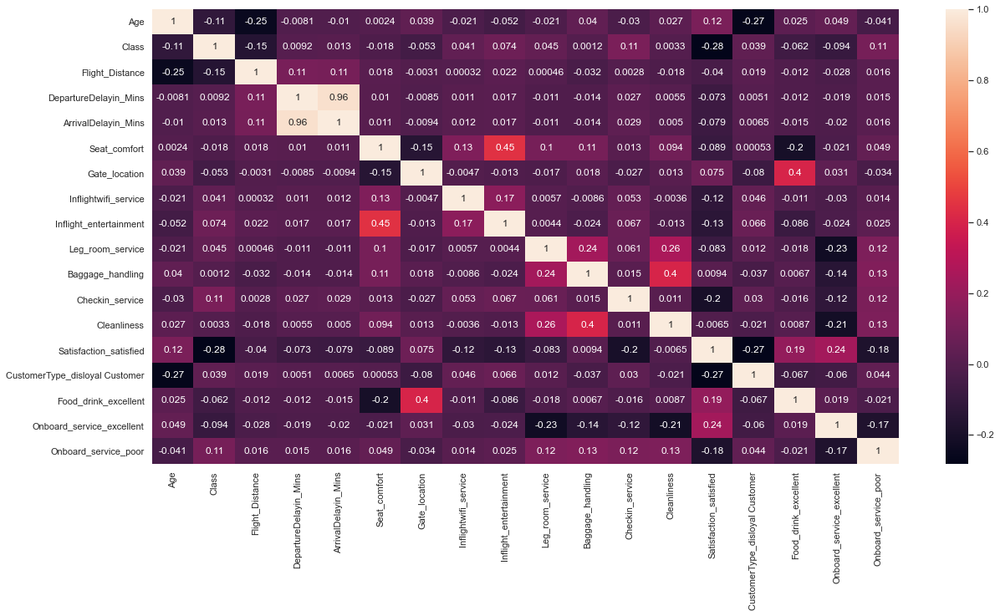

In [43]:
plt.figure(figsize=(20,10))
sns.heatmap(falcon_airline_data.corr(),annot=True)
plt.show()

Age has a weak positive correlation with satisfaction
Class also has a weak correlation with checkin service and onboard service poor, this could be because business class passengers have high expectations of service that should be offered to them and it is more likely that falcon airline is meeting up.
flight distance is positively correlated to delay on both arrival and departure but it doesn't mean that the longer the distance the longer the delay, however short or longer distance could be taken by the airline to save cost.
arrival delay in min shares a strong positive correlation  with departure delay in mins 
Seat comfort is positively correlated to baggage handling, it could be that if all bags are placed in the over head compartment passengers could be more comfortable 
Gate location is strongly correlated with food drink that was rated excellent by passengers
Inflight entertainment is postively correlrated to inflight wifi service
Leg room, cleanliness,baggage handling,seat comfort and Onboard service rated poor by passengers share a weak or poor correlation 


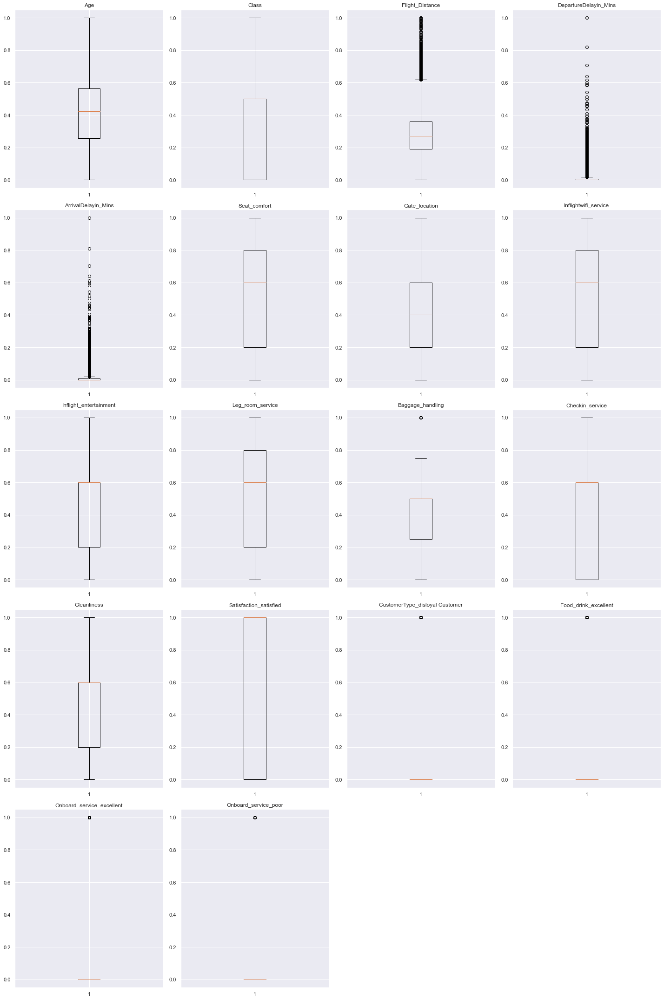

In [26]:
#treating outliers 
# outlier detection using boxplot
numerical_col = falcon_airline_data.select_dtypes(include=np.number).columns.tolist()
plt.figure(figsize=(20,30))

for i, variable in enumerate(numerical_col):
                     plt.subplot(5,4,i+1)
                     plt.boxplot(falcon_airline_data[variable],whis=1.5)
                     plt.tight_layout()
                     plt.title(variable)

plt.show()

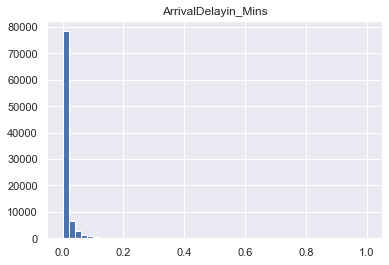

50949


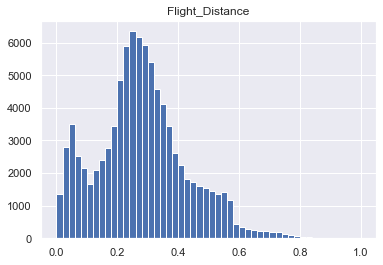

16


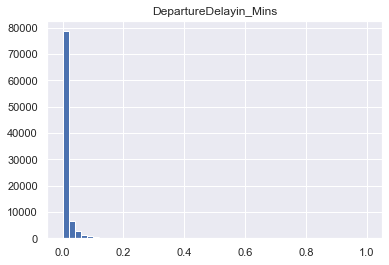

51338


In [27]:
cols_to_log = ['ArrivalDelayin_Mins', 'Flight_Distance','DepartureDelayin_Mins']
for colname in cols_to_log:
    plt.hist(falcon_airline_data[colname], bins=50)
    plt.title(colname)
    plt.show()
    print(np.sum(falcon_airline_data[colname] <= 0))

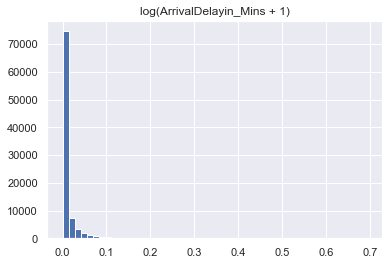

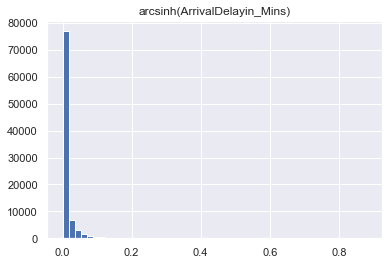

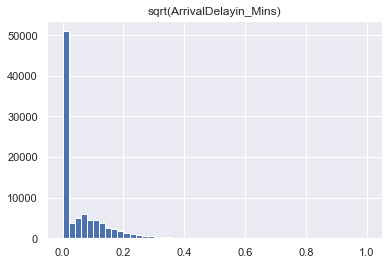

In [28]:
plt.hist(np.log(falcon_airline_data['ArrivalDelayin_Mins'] + 1), 50)
plt.title('log(ArrivalDelayin_Mins + 1)')
plt.show()
plt.hist(np.arcsinh(falcon_airline_data['ArrivalDelayin_Mins']), 50)
plt.title('arcsinh(ArrivalDelayin_Mins)')
plt.show()
plt.hist(np.sqrt(falcon_airline_data['ArrivalDelayin_Mins']), 50)
plt.title('sqrt(ArrivalDelayin_Mins)')
plt.show()

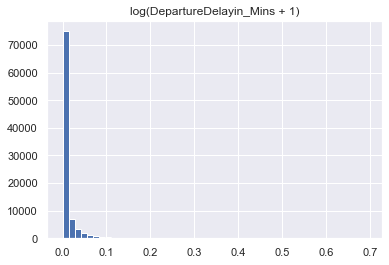

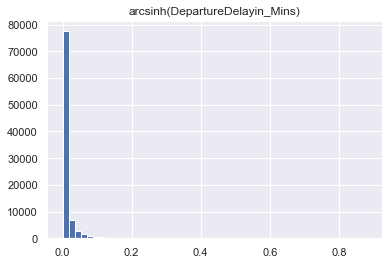

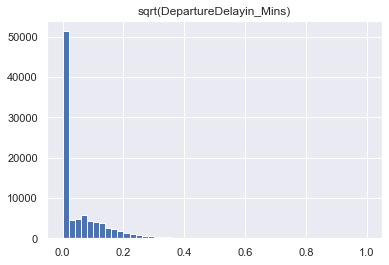

In [29]:
plt.hist(np.log(falcon_airline_data['DepartureDelayin_Mins'] + 1), 50)
plt.title('log(DepartureDelayin_Mins + 1)')
plt.show()
plt.hist(np.arcsinh(falcon_airline_data['DepartureDelayin_Mins']), 50)
plt.title('arcsinh(DepartureDelayin_Mins)')
plt.show()
plt.hist(np.sqrt(falcon_airline_data['DepartureDelayin_Mins']), 50)
plt.title('sqrt(DepartureDelayin_Mins)')
plt.show()

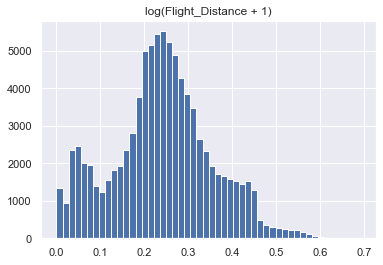

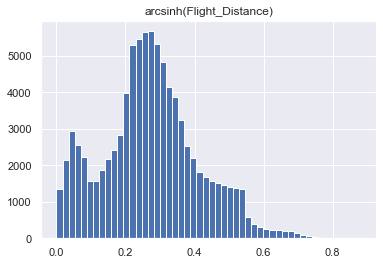

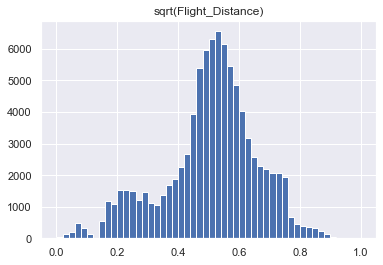

In [30]:
plt.hist(np.log(falcon_airline_data['Flight_Distance'] + 1), 50)
plt.title('log(Flight_Distance + 1)')
plt.show()
plt.hist(np.arcsinh(falcon_airline_data['Flight_Distance']), 50)
plt.title('arcsinh(Flight_Distance)')
plt.show()
plt.hist(np.sqrt(falcon_airline_data['Flight_Distance']), 50)
plt.title('sqrt(Flight_Distance)')
plt.show()

In [31]:
for colname in cols_to_log:
    falcon_airline_data[colname + '_log'] = np.log(falcon_airline_data[colname] + 1)
falcon_airline_data.drop(cols_to_log, axis=1, inplace=True)

Exploratory data analysis 

In [32]:
falcon_airline_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90917 entries, 0 to 90916
Data columns (total 18 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Age                             90917 non-null  float64
 1   Class                           90917 non-null  float64
 2   Seat_comfort                    90917 non-null  float64
 3   Gate_location                   90917 non-null  float64
 4   Inflightwifi_service            90917 non-null  float64
 5   Inflight_entertainment          90917 non-null  float64
 6   Leg_room_service                90917 non-null  float64
 7   Baggage_handling                90917 non-null  float64
 8   Checkin_service                 90917 non-null  float64
 9   Cleanliness                     90917 non-null  float64
 10  Satisfaction_satisfied          90917 non-null  float64
 11  CustomerType_disloyal Customer  90917 non-null  float64
 12  Food_drink_excellent            

In [33]:
def histogram_boxplot(feature, figsize=(15,10), bins = None):
    """ Boxplot and histogram combined
    feature: 1-d feature array
    figsize: size of fig (default (9,8))
    bins: number of bins (default None / auto)
    """
    f2, (ax_box2, ax_hist2) = plt.subplots(nrows = 2, # Number of rows of the subplot grid= 2
                                           sharex = True, # x-axis will be shared among all subplots
                                           gridspec_kw = {"height_ratios": (.25, .75)}, 
                                           figsize = figsize 
                                           ) # creating the 2 subplots
    sns.boxplot(feature, ax=ax_box2, showmeans=True, color='white') # boxplot will be created and a star will indicate the mean value of the column
    sns.distplot(feature, kde=F, ax=ax_hist2, bins=bins,palette="PuBu") if bins else sns.distplot(feature, kde=False, ax=ax_hist2) # For histogram
    ax_hist2.axvline(np.mean(feature), color='green', linestyle='--') # Add mean to the histogram
    ax_hist2.axvline(np.median(feature), color='black', linestyle='-') # Add median to the histogram

C:\Users\user\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\user\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


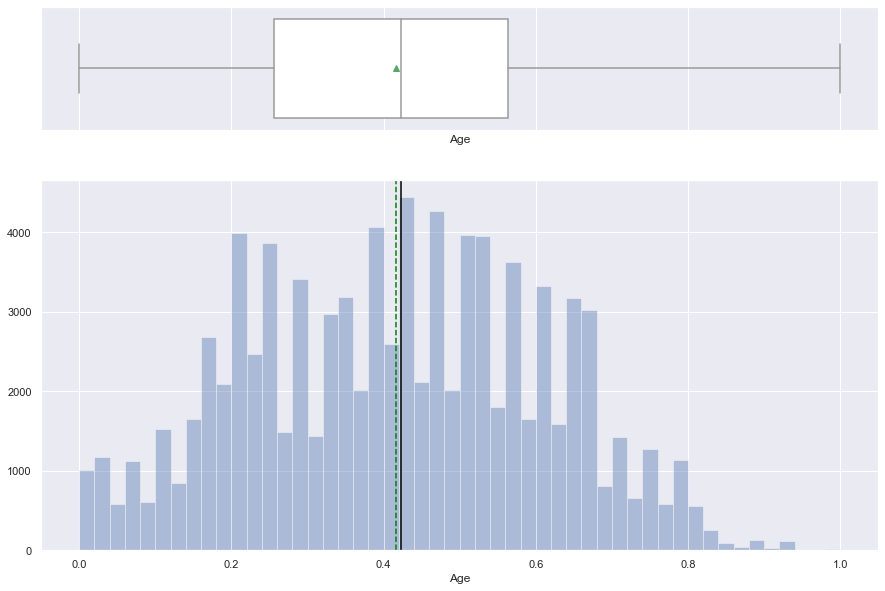

In [54]:
histogram_boxplot(falcon_airline_data["Age"])

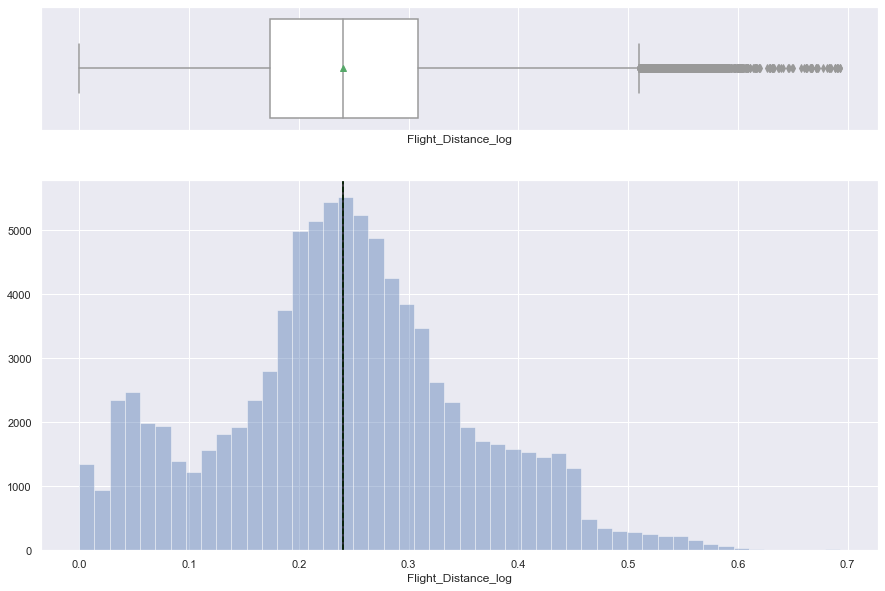

In [34]:
histogram_boxplot(falcon_airline_data["Flight_Distance_log"])

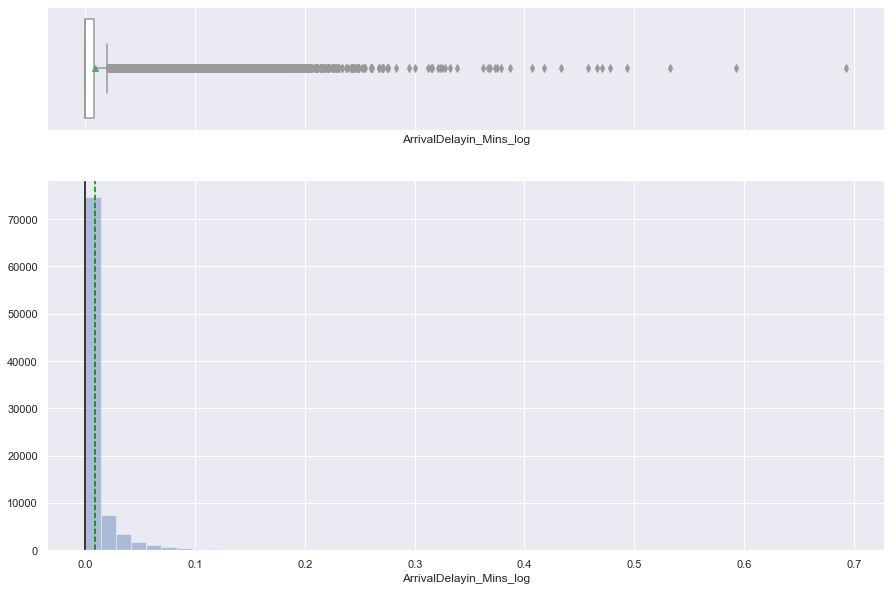

In [35]:
histogram_boxplot(falcon_airline_data["ArrivalDelayin_Mins_log"])

C:\Users\user\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\user\anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


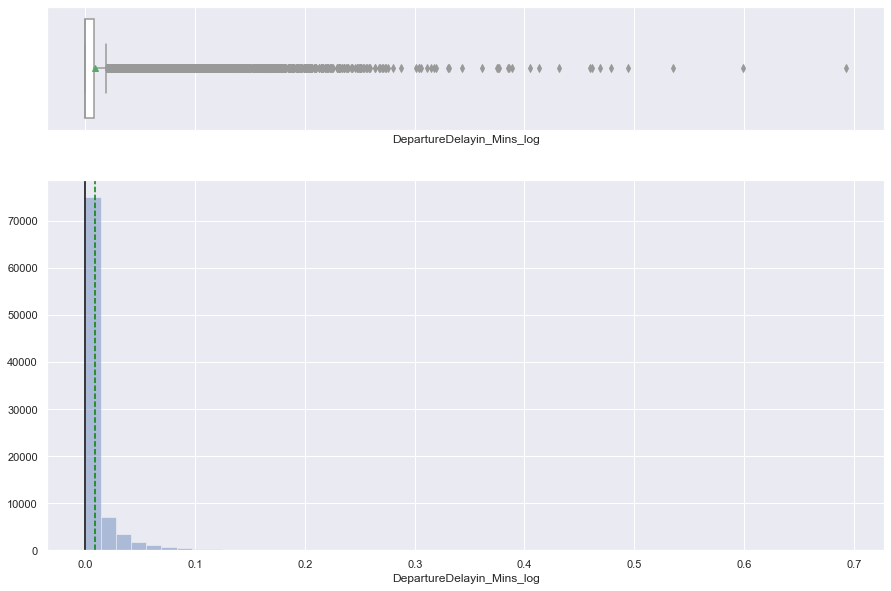

In [58]:
histogram_boxplot(falcon_airline_data["DepartureDelayin_Mins_log"])

In [ ]:
#Change data back to categorical 
falcon_airline_data["Class"]=falcon_airline_data["Class"].astype("category")
falcon_airline_data["Seat_comfort"]=falcon_airline_data["Seat_comfort"].astype("category")
falcon_airline_data["Gate_location"]=falcon_airline_data["Gate_location"].astype("category")
falcon_airline_data["Inflightwifi_service"]=falcon_airline_data["Inflightwifi_service"].astype("category")
falcon_airline_data["Inflight_entertainment"]=falcon_airline_data["Inflight_entertainment"].astype("category")
falcon_airline_data["Leg_room_service"]=falcon_airline_data["Leg_room_service"].astype("category")
falcon_airline_data["Baggage_handling"]=falcon_airline_data["Baggage_handling"].astype("category")
falcon_airline_data["Checkin_service"]=falcon_airline_data["Checkin_service"].astype("category")
falcon_airline_data["Cleanliness"]=falcon_airline_data["Cleanliness"].astype("category")
falcon_airline_data["Satisfaction_satisfied"]=falcon_airline_data["Satisfaction_satisfied"].astype("category")
falcon_airline_data["CustomerType_disloyal Customer"]=falcon_airline_data["CustomerType_disloyal Customer"].astype("category")
falcon_airline_data["Food_drink_excellent"]=falcon_airline_data["Food_drink_excellent"].astype("category")
falcon_airline_data["Onboard_service_excellent"]=falcon_airline_data["Onboard_service_excellent"].astype("category")
falcon_airline_data["Onboard_service_poor"]=falcon_airline_data["Onboard_service_poor"].astype("category")

In [38]:
def stacked_plot(x):
    sns.set(palette='nipy_spectral')
    tab1 = pd.crosstab(x,falcon_airline_data['Satisfaction_satisfied'],margins=True)
    print(tab1)
    print('-'*120)
    tab = pd.crosstab(x,falcon_airline_data['Satisfaction_satisfied'],normalize='index')
    tab.plot(kind='bar',stacked=True,figsize=(10,5))
    plt.legend(loc='lower left', frameon=False)
    plt.legend(loc="upper left", bbox_to_anchor=(1,1))
    plt.show()

Satisfaction_satisfied    0.0    1.0    All
Class                                      
0.0                     12600  30935  43535
0.5                     24755  16003  40758
1.0                      3801   2823   6624
All                     41156  49761  90917
------------------------------------------------------------------------------------------------------------------------


<Figure size 648x648 with 0 Axes>

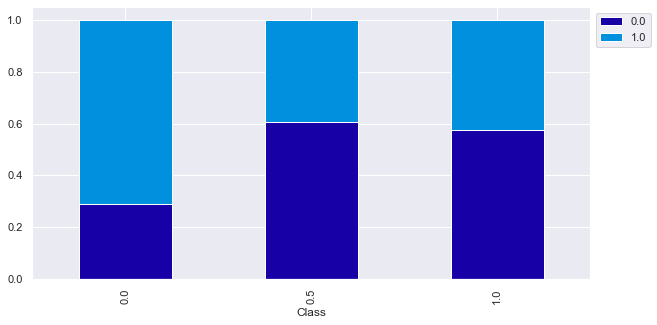

Satisfaction_satisfied    0.0    1.0    All
Seat_comfort                               
0.0                     13274   7278  20552
0.2                        97  12422  12519
0.4                         6   3362   3368
0.6000000000000001       6878  12911  19789
0.8                     12904   7098  20002
1.0                      7997   6690  14687
All                     41156  49761  90917
------------------------------------------------------------------------------------------------------------------------


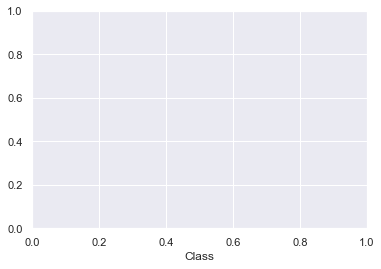

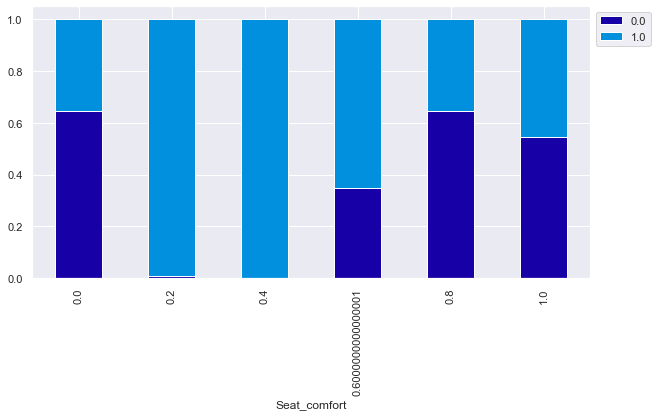

Satisfaction_satisfied    0.0    1.0    All
Gate_location                              
0.0                     10621  10467  21088
0.2                      6133   9743  15876
0.4                     12585  10800  23385
0.6000000000000001       7222   9891  17113
0.8                      4595   8859  13454
1.0                         0      1      1
All                     41156  49761  90917
------------------------------------------------------------------------------------------------------------------------


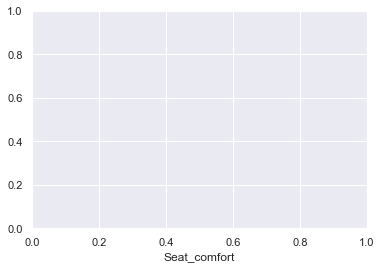

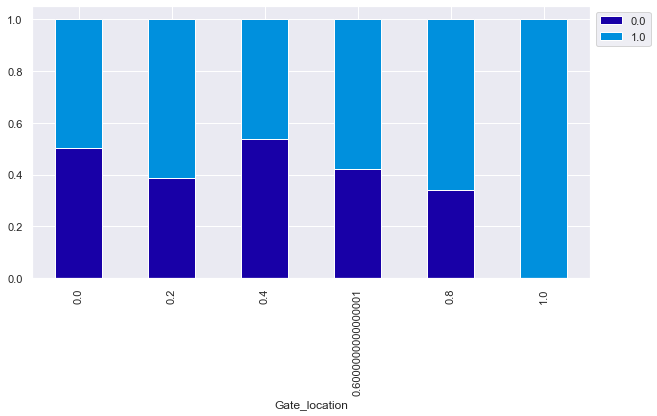

Satisfaction_satisfied    0.0    1.0    All
Inflightwifi_service                       
0.0                      9382   9817  19199
0.2                      6753  13505  20258
0.4                        53     43     96
0.6000000000000001       7994  14165  22159
0.8                      9447   9447  18894
1.0                      7527   2784  10311
All                     41156  49761  90917
------------------------------------------------------------------------------------------------------------------------


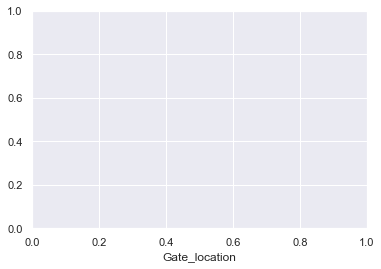

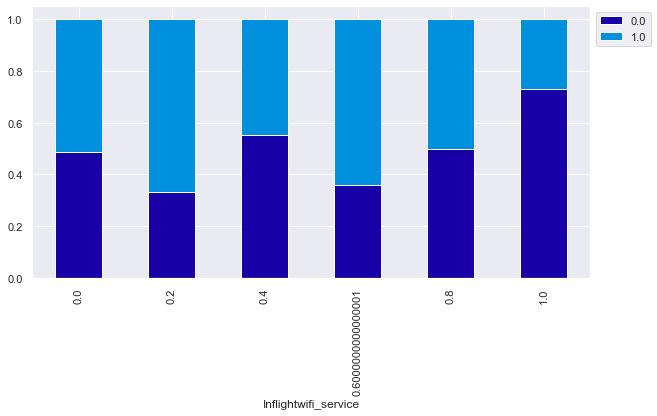

Satisfaction_satisfied    0.0    1.0    All
Satisfaction_satisfied                     
0.0                     41156      0  41156
1.0                         0  49761  49761
All                     41156  49761  90917
------------------------------------------------------------------------------------------------------------------------


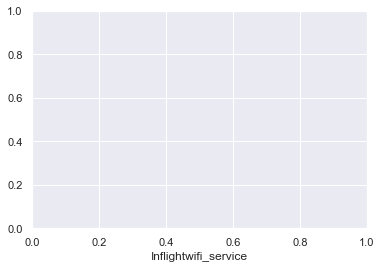

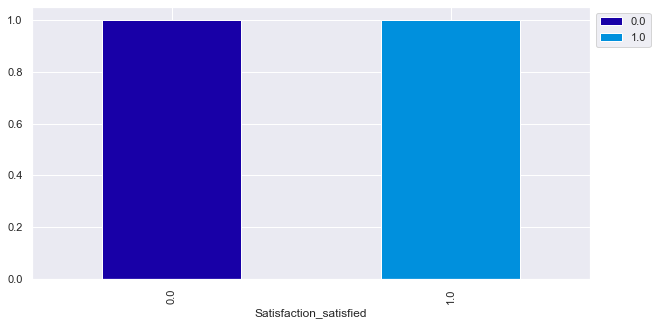

Satisfaction_satisfied    0.0    1.0    All
Baggage_handling                           
0.0                     11771   5462  17233
0.25                     6629  18373  25002
0.5                     13927  19895  33822
0.75                     5627   3674   9301
1.0                      3202   2357   5559
All                     41156  49761  90917
------------------------------------------------------------------------------------------------------------------------


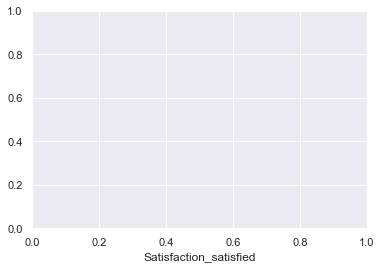

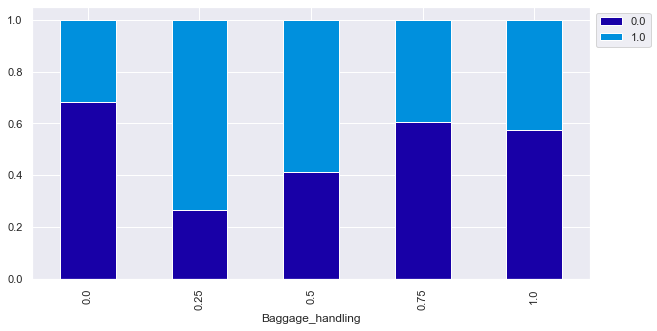

Satisfaction_satisfied    0.0    1.0    All
Checkin_service                            
0.0                     10832  14109  24941
0.2                      5005  13913  18918
0.4                         1      0      1
0.6000000000000001      10728  14755  25483
0.8                      7238   3575  10813
1.0                      7352   3409  10761
All                     41156  49761  90917
------------------------------------------------------------------------------------------------------------------------


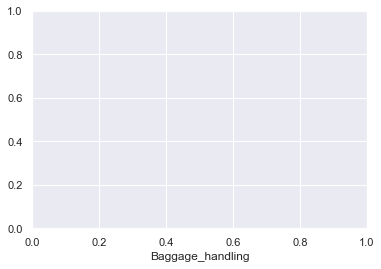

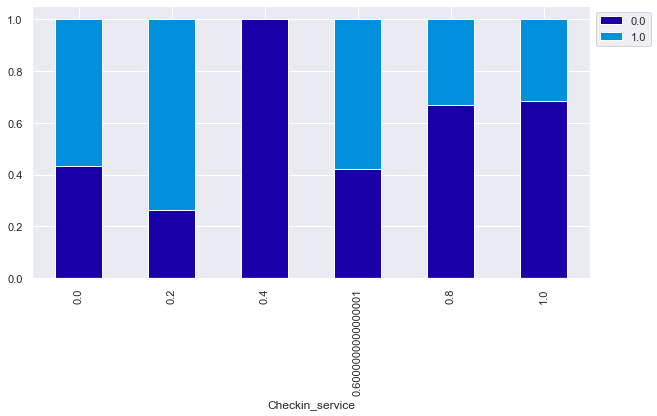

Satisfaction_satisfied    0.0    1.0    All
Cleanliness                                
0.0                     11543   5387  16930
0.2                      6730  18349  25079
0.4                         4      0      4
0.6000000000000001      14151  20095  34246
0.8                      5544   3739   9283
1.0                      3184   2191   5375
All                     41156  49761  90917
------------------------------------------------------------------------------------------------------------------------


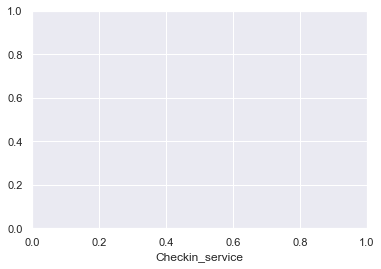

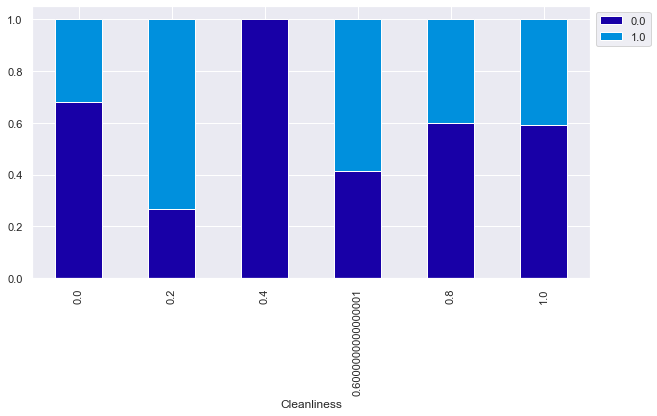

Satisfaction_satisfied            0.0    1.0    All
CustomerType_disloyal Customer                     
0.0                             29805  46191  75996
1.0                             11351   3570  14921
All                             41156  49761  90917
------------------------------------------------------------------------------------------------------------------------


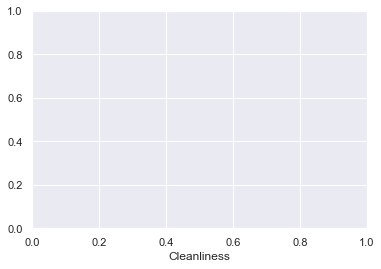

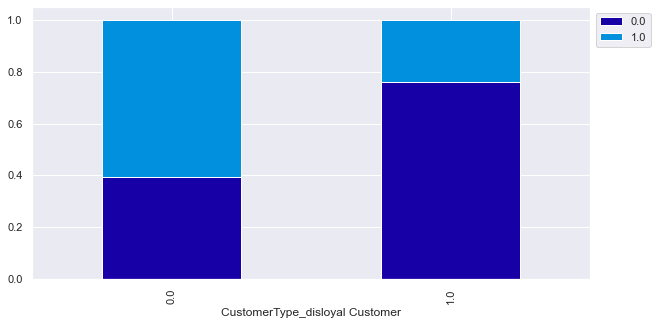

Satisfaction_satisfied    0.0    1.0    All
Food_drink_excellent                       
0.0                     38305  39665  77970
1.0                      2851  10096  12947
All                     41156  49761  90917
------------------------------------------------------------------------------------------------------------------------


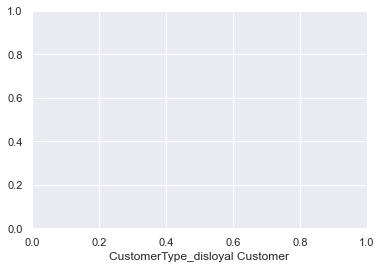

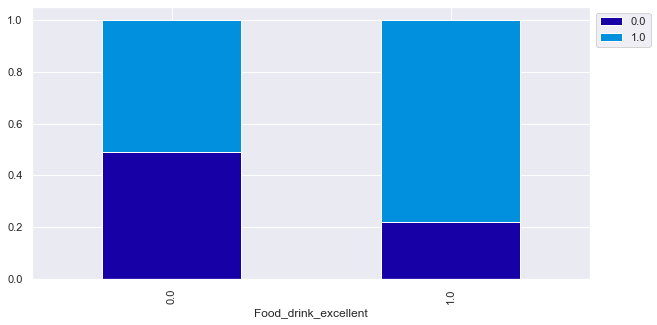

Satisfaction_satisfied       0.0    1.0    All
Onboard_service_excellent                     
0.0                        36387  34134  70521
1.0                         4769  15627  20396
All                        41156  49761  90917
------------------------------------------------------------------------------------------------------------------------


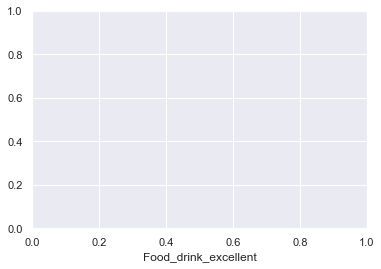

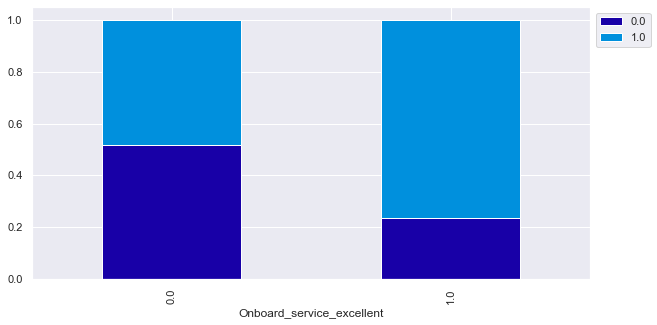

Satisfaction_satisfied    0.0    1.0    All
Onboard_service_poor                       
0.0                     34920  47460  82380
1.0                      6236   2301   8537
All                     41156  49761  90917
------------------------------------------------------------------------------------------------------------------------


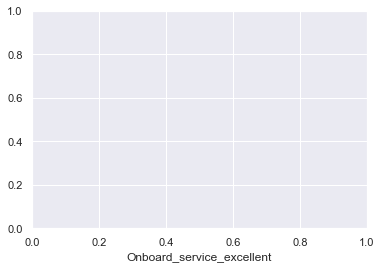

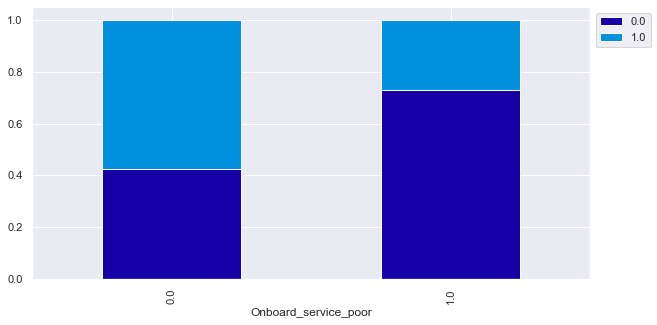

Satisfaction_satisfied    0.0    1.0    All
Leg_room_service                           
0.0                      9952   5823  15775
0.2                      7018  17053  24071
0.4                       104    218    322
0.6000000000000001       9051  18763  27814
0.8                      9475   5681  15156
1.0                      5556   2223   7779
All                     41156  49761  90917
------------------------------------------------------------------------------------------------------------------------


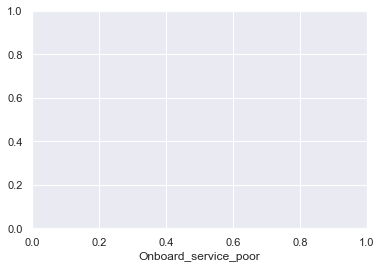

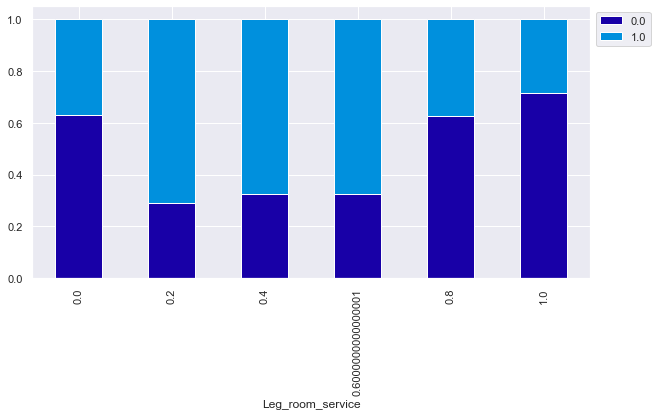

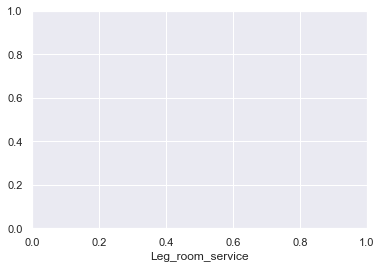

In [39]:
categorical_val = ['Class','Seat_comfort','Gate_location','Inflightwifi_service','Satisfaction_satisfied','Baggage_handling','Checkin_service','Cleanliness','CustomerType_disloyal Customer','Food_drink_excellent','Onboard_service_excellent','Onboard_service_poor','Leg_room_service']

plt.figure(figsize=(9,9))
for i , column in enumerate(categorical_val,1):
    stacked_plot(falcon_airline_data[column])
    plt.xlabel(column)

In [40]:

def perc_on_bar(plot, feature):
    '''
    plot
    feature: categorical feature
    the function won't work if a column is passed in hue parameter
    '''
    total = len(feature) # length of the column
    for p in ax.patches:
        percentage = '{:.1f}%'.format(100 * p.get_height()/total) # percentage of each class of the category
        x = p.get_x() + p.get_width() / 2 - 0.05 # width of the plot
        y = p.get_y() + p.get_height()           # hieght of the plot
        ax.annotate(percentage, (x, y), size = 12) # annotate the percantage 
    plt.show() # show the plot

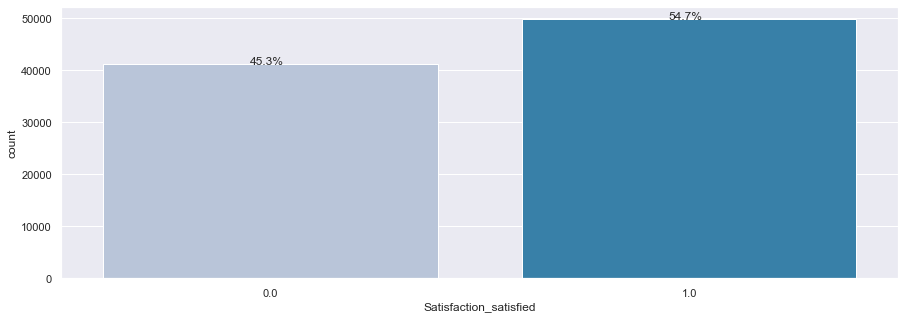

In [41]:
plt.figure(figsize=(15,5))
ax = sns.countplot(falcon_airline_data["Satisfaction_satisfied"],palette='PuBu')
perc_on_bar(ax,falcon_airline_data["Satisfaction_satisfied"])

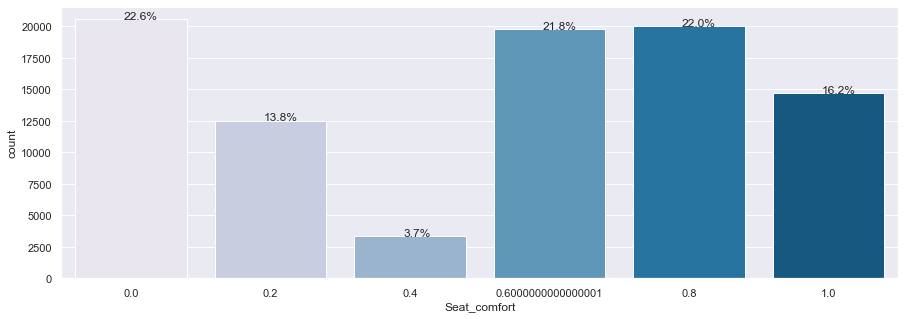

In [42]:
plt.figure(figsize=(15,5))
ax = sns.countplot(falcon_airline_data["Seat_comfort"],palette='PuBu')
perc_on_bar(ax,falcon_airline_data["Seat_comfort"])

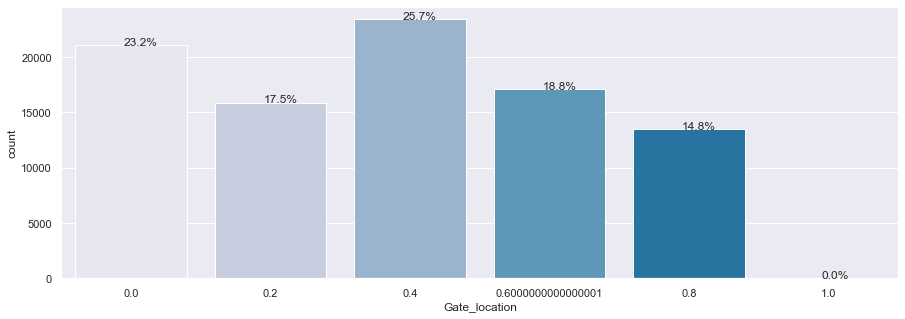

In [43]:
plt.figure(figsize=(15,5))
ax = sns.countplot(falcon_airline_data["Gate_location"],palette='PuBu')
perc_on_bar(ax,falcon_airline_data["Gate_location"])

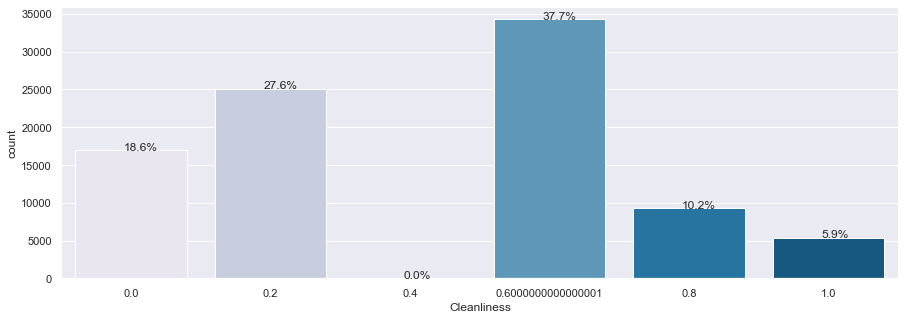

In [44]:
plt.figure(figsize=(15,5))
ax = sns.countplot(falcon_airline_data["Cleanliness"],palette='PuBu')
perc_on_bar(ax,falcon_airline_data["Cleanliness"])

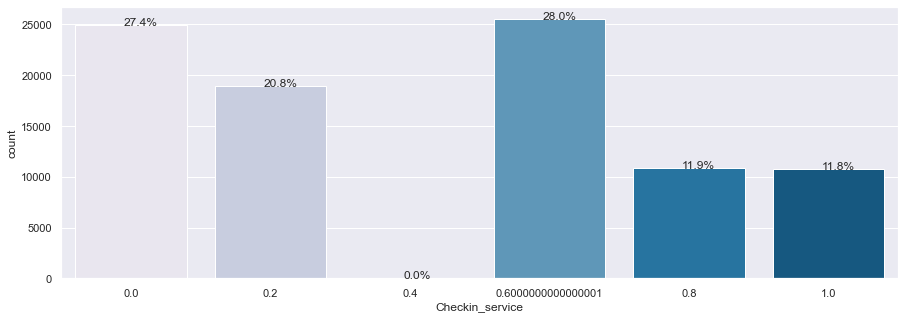

In [45]:
plt.figure(figsize=(15,5))
ax = sns.countplot(falcon_airline_data["Checkin_service"],palette='PuBu')
perc_on_bar(ax,falcon_airline_data["Checkin_service"])

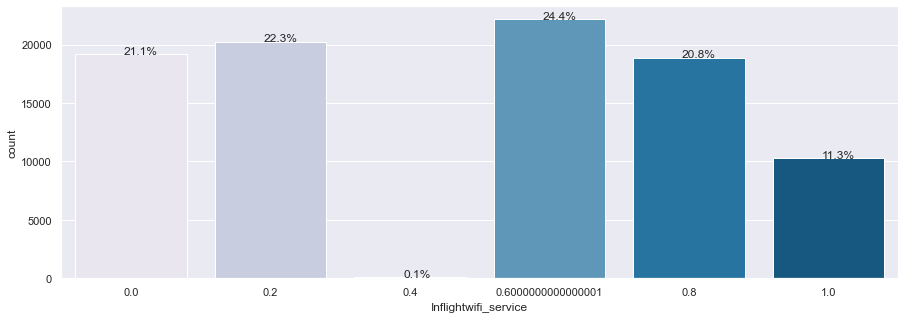

In [47]:
plt.figure(figsize=(15,5))
ax = sns.countplot(falcon_airline_data["Inflightwifi_service"],palette='PuBu')
perc_on_bar(ax,falcon_airline_data["Inflightwifi_service"])

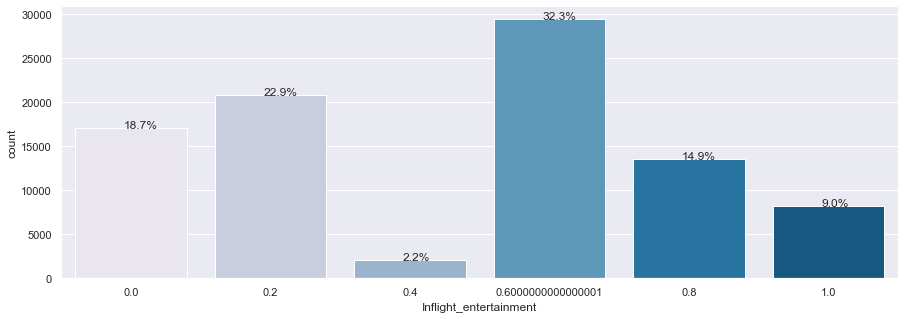

In [48]:
plt.figure(figsize=(15,5))
ax = sns.countplot(falcon_airline_data["Inflight_entertainment"],palette='PuBu')
perc_on_bar(ax,falcon_airline_data["Inflight_entertainment"])

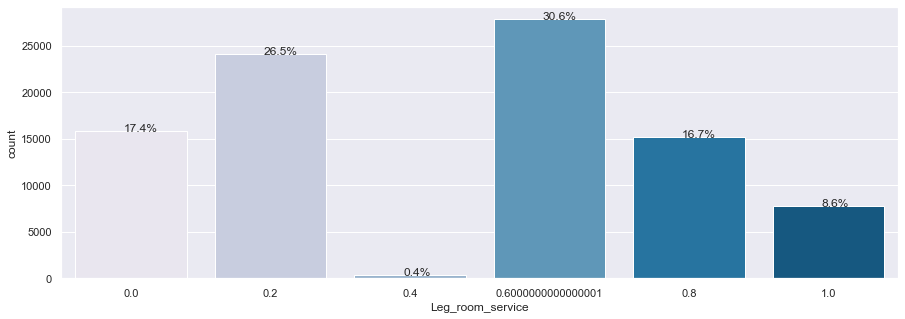

In [49]:
plt.figure(figsize=(15,5))
ax = sns.countplot(falcon_airline_data["Leg_room_service"],palette='PuBu')
perc_on_bar(ax,falcon_airline_data["Leg_room_service"])

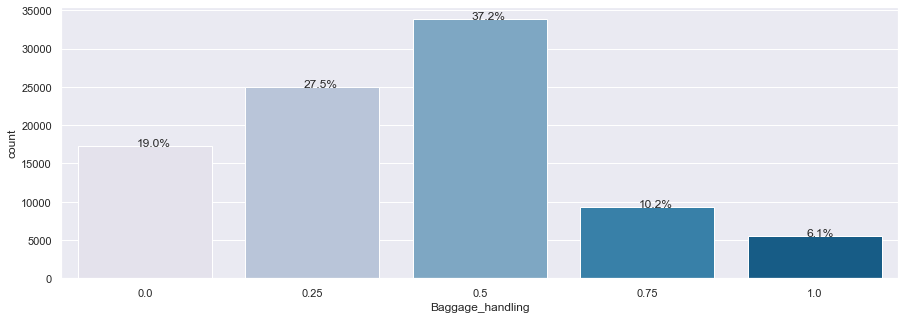

In [50]:
plt.figure(figsize=(15,5))
ax = sns.countplot(falcon_airline_data["Baggage_handling"],palette='PuBu')
perc_on_bar(ax,falcon_airline_data["Baggage_handling"])

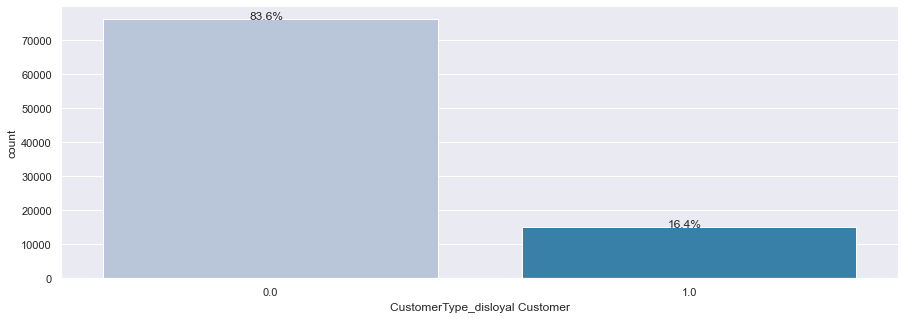

In [51]:
plt.figure(figsize=(15,5))
ax = sns.countplot(falcon_airline_data["CustomerType_disloyal Customer"],palette='PuBu')
perc_on_bar(ax,falcon_airline_data["CustomerType_disloyal Customer"])

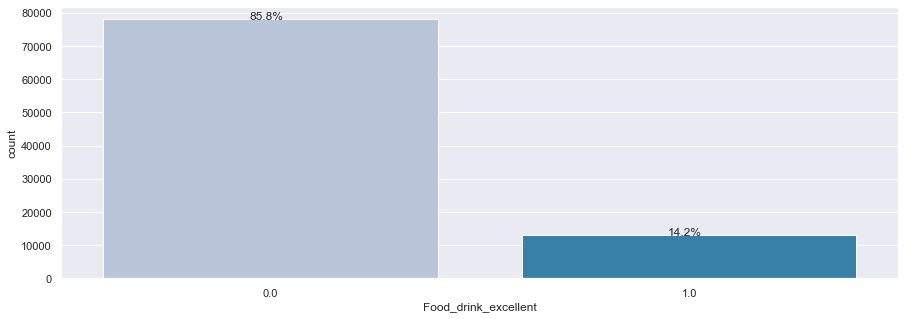

In [52]:
plt.figure(figsize=(15,5))
ax = sns.countplot(falcon_airline_data["Food_drink_excellent"],palette='PuBu')
perc_on_bar(ax,falcon_airline_data["Food_drink_excellent"])

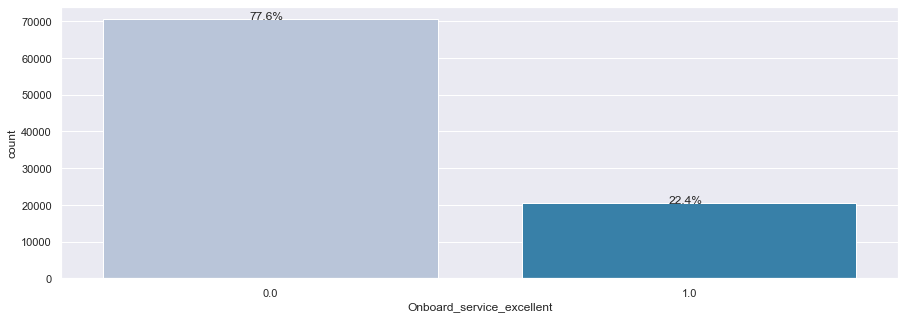

In [53]:
plt.figure(figsize=(15,5))
ax = sns.countplot(falcon_airline_data["Onboard_service_excellent"],palette='PuBu')
perc_on_bar(ax,falcon_airline_data["Onboard_service_excellent"])

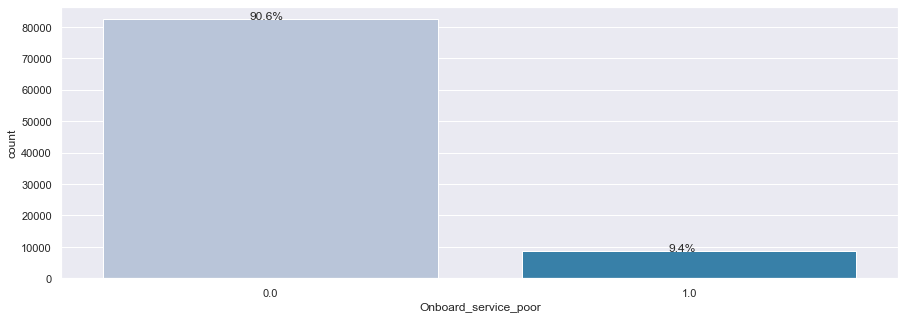

In [54]:
plt.figure(figsize=(15,5))
ax = sns.countplot(falcon_airline_data["Onboard_service_poor"],palette='PuBu')
perc_on_bar(ax,falcon_airline_data["Onboard_service_poor"])

C:\Users\Osilade\anaconda3\lib\site-packages\seaborn\distributions.py:369: UserWarning: Default bandwidth for data is 0; skipping density estimation.
  warnings.warn(msg, UserWarning)
C:\Users\Osilade\anaconda3\lib\site-packages\seaborn\distributions.py:369: UserWarning: Default bandwidth for data is 0; skipping density estimation.
  warnings.warn(msg, UserWarning)
C:\Users\Osilade\anaconda3\lib\site-packages\seaborn\distributions.py:369: UserWarning: Default bandwidth for data is 0; skipping density estimation.
  warnings.warn(msg, UserWarning)
C:\Users\Osilade\anaconda3\lib\site-packages\seaborn\distributions.py:369: UserWarning: Default bandwidth for data is 0; skipping density estimation.
  warnings.warn(msg, UserWarning)
C:\Users\Osilade\anaconda3\lib\site-packages\seaborn\distributions.py:369: UserWarning: Default bandwidth for data is 0; skipping density estimation.
  warnings.warn(msg, UserWarning)
C:\Users\Osilade\anaconda3\lib\site-packages\seaborn\distributions.py:369: UserW

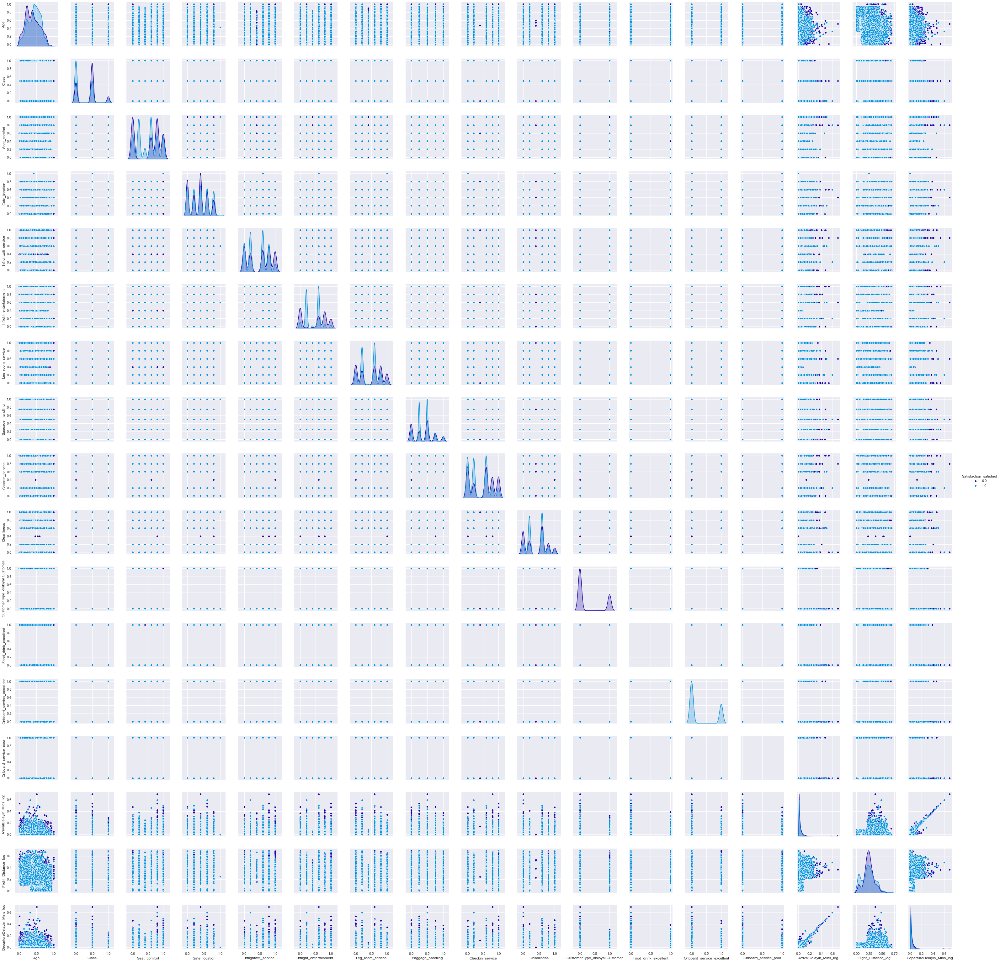

In [56]:
sns.pairplot(falcon_airline_data,hue="Satisfaction_satisfied")  
plt.show()

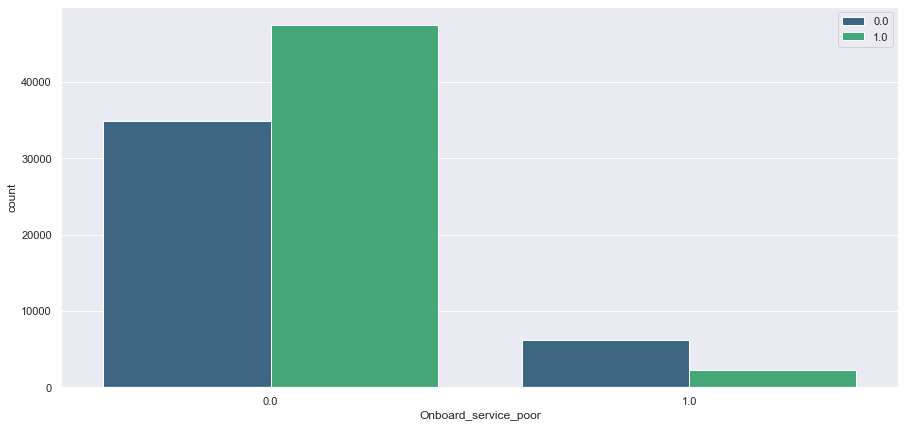

In [61]:
plt.figure(figsize=(15,7))
sns.countplot(falcon_airline_data["Onboard_service_poor"],hue=falcon_airline_data["Satisfaction_satisfied"],palette="viridis")
plt.legend(bbox_to_anchor=(1.00, 1))
plt.show()

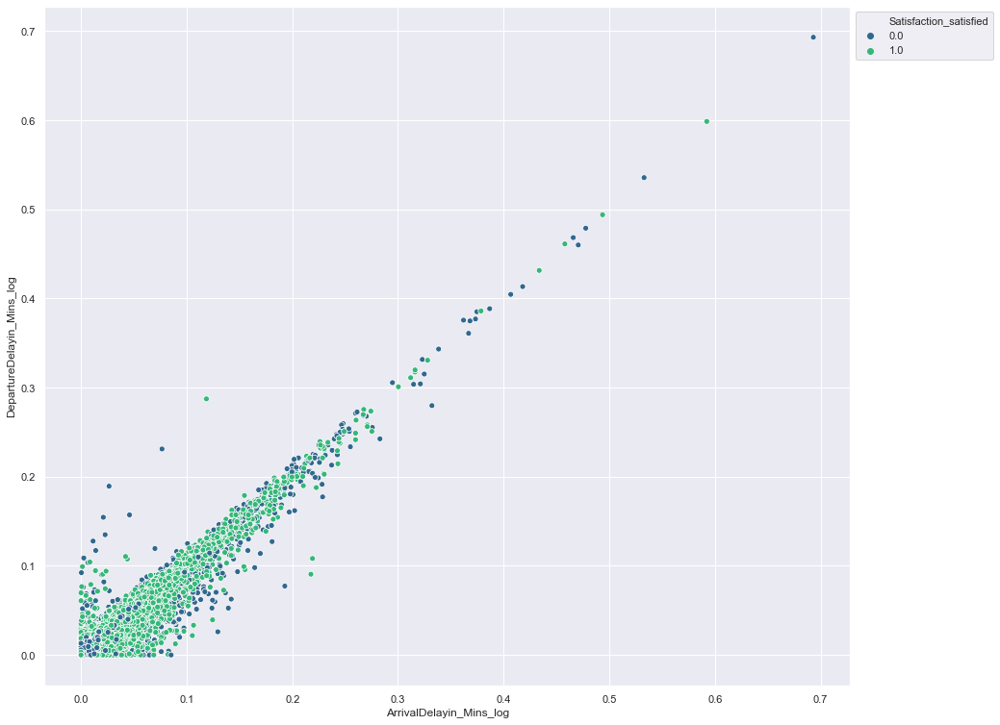

In [73]:
plt.figure(figsize=(15,13))
sns.scatterplot(falcon_airline_data["ArrivalDelayin_Mins_log"],falcon_airline_data["DepartureDelayin_Mins_log"],hue=falcon_airline_data["Satisfaction_satisfied"],palette="viridis")
plt.legend(bbox_to_anchor=(1.00, 1))
plt.show()

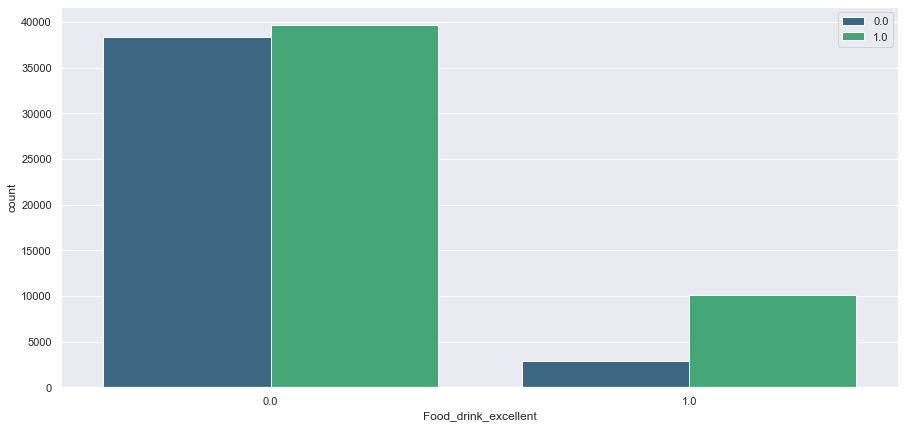

In [64]:
plt.figure(figsize=(15,7))
sns.countplot(falcon_airline_data["Food_drink_excellent"],hue=falcon_airline_data["Satisfaction_satisfied"],palette="viridis")
plt.legend(bbox_to_anchor=(1.00, 1))
plt.show()

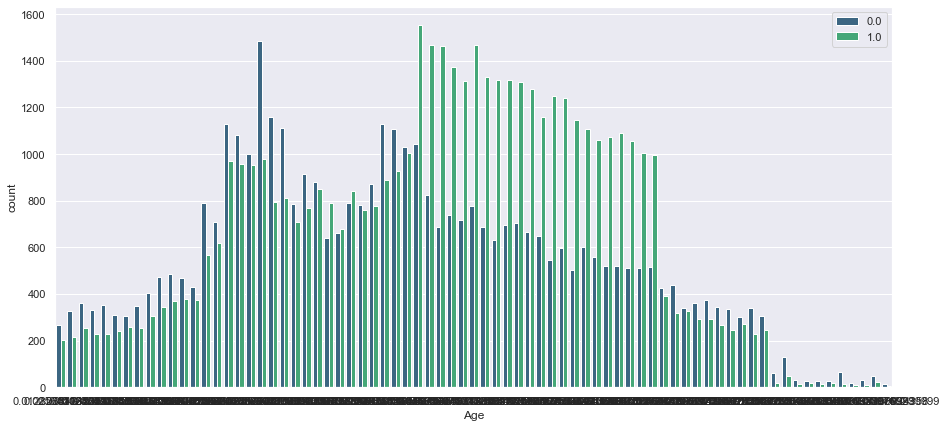

In [72]:
plt.figure(figsize=(15,7))
sns.countplot(falcon_airline_data["Age"],hue=falcon_airline_data["Satisfaction_satisfied"],palette="viridis")
plt.legend(bbox_to_anchor=(1.00, 1))
plt.show()

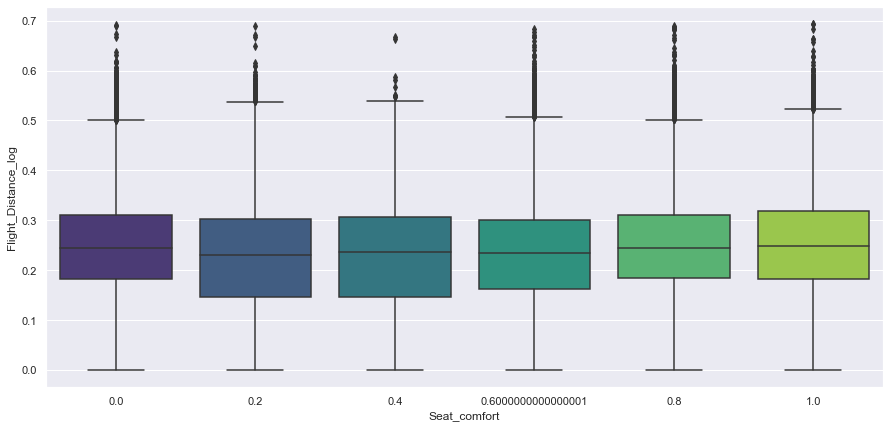

In [79]:
plt.figure(figsize=(15,7))
sns.boxplot(falcon_airline_data["Seat_comfort"],falcon_airline_data["Flight_Distance_log"],palette="viridis")
plt.show()

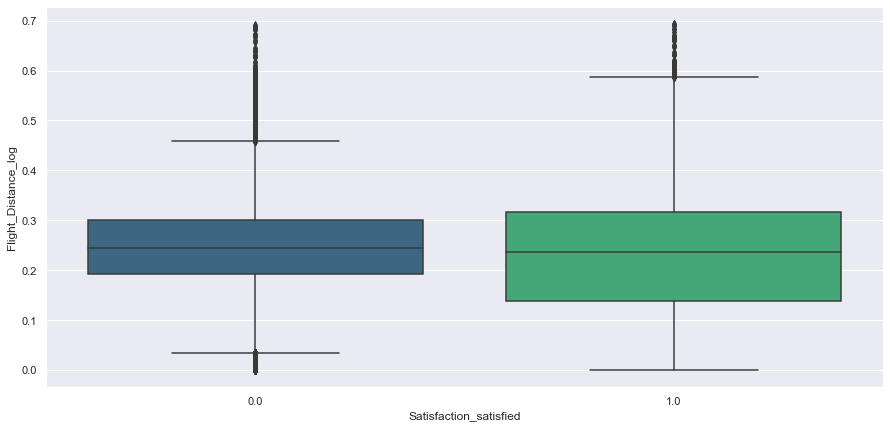

In [81]:
plt.figure(figsize=(15,7))
sns.boxplot(falcon_airline_data["Satisfaction_satisfied"],falcon_airline_data["Flight_Distance_log"],palette="viridis")
plt.show()

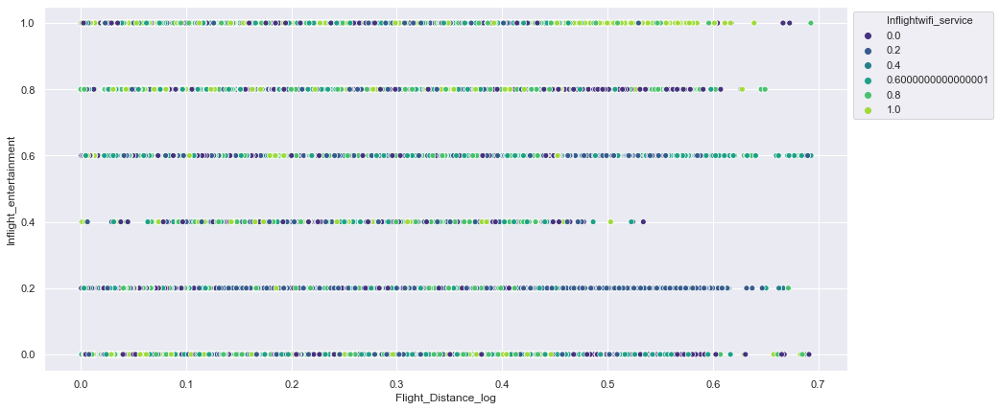

In [83]:
plt.figure(figsize=(15,7))
sns.scatterplot(falcon_airline_data["Flight_Distance_log"],falcon_airline_data["Inflight_entertainment"],hue=falcon_airline_data["Inflightwifi_service"],palette="viridis")
plt.legend(bbox_to_anchor=(1.00, 1))
plt.show()

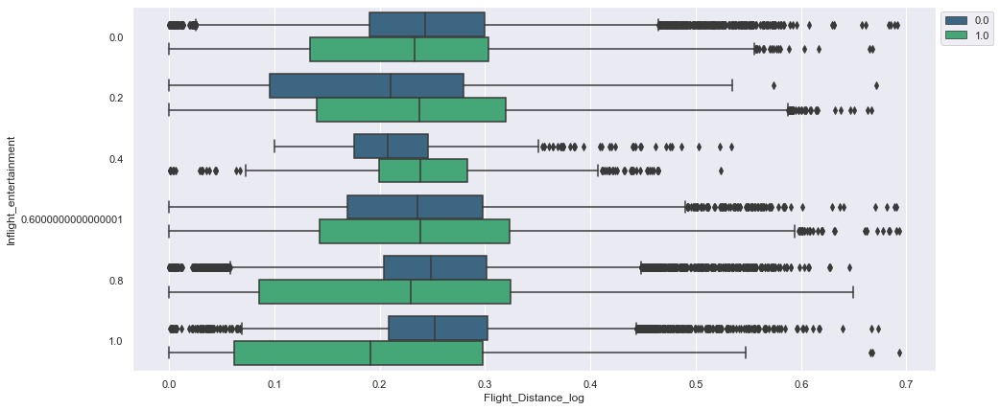

In [86]:
plt.figure(figsize=(15,7))
sns.boxplot(falcon_airline_data["Flight_Distance_log"],falcon_airline_data["Inflight_entertainment"],hue=falcon_airline_data["Satisfaction_satisfied"],palette="viridis")
plt.legend(bbox_to_anchor=(1.00, 1))
plt.show()

Evaluating satisfied 

In [30]:
print('No. of 0s' , (falcon_airline_data.Satisfaction_satisfied== 0).sum(axis=0))
print('No. of 1s' , (falcon_airline_data.Satisfaction_satisfied == 1).sum(axis=0))

No. of 0s 41156
No. of 1s 49761


In [37]:
#defining X and Y
X = falcon_airline_data.drop(['Satisfaction_satisfied'], axis=1)
Y = falcon_airline_data[['Satisfaction_satisfied']] 

In [ ]:
#split the data into train and test
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.3, random_state=42)

In [34]:
print('Original dataset', Y.Satisfaction_satisfied.value_counts(normalize=True))
print('Train dataset', y_train.Satisfaction_satisfied.value_counts(normalize=True))
print('Test dataset', y_test.Satisfaction_satisfied.value_counts(normalize=True))

Original dataset 1.0    0.547323
0.0    0.452677
Name: Satisfaction_satisfied, dtype: float64
Train dataset 1.0    0.54787
0.0    0.45213
Name: Satisfaction_satisfied, dtype: float64
Test dataset 1.0    0.546048
0.0    0.453952
Name: Satisfaction_satisfied, dtype: float64


In [64]:
print("Number of rows in train data =", X_train.shape[0])
print("Number of rows in train data =", X_test.shape[0])

Number of rows in train data = 63641
Number of rows in train data = 17


In [71]:
print("Number of rows in train data =", y_train.shape[0])
print("Number of rows in train data =", y_test.shape[0])

Number of rows in train data = 63641
Number of rows in train data = 27276


In [48]:
X_train.shape, X_test.shape

((63641, 17), (27276, 17))

Logistic regression 

In [34]:
# dataframe with numerical column only
num_feature_set = X.copy()
from statsmodels.tools.tools import add_constant
num_feature_set = add_constant(num_feature_set)

In [40]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif_series1 = pd.Series([variance_inflation_factor(num_feature_set.values,i) for i in range(num_feature_set.shape[1])],index=num_feature_set.columns)
print('Series before feature selection: \n\n{}\n'.format(vif_series1))

Series before feature selection: 

const                             29.464758
Age                                1.189217
Class                              1.089495
Seat_comfort                       1.364746
Gate_location                      1.216090
Inflightwifi_service               1.038377
Inflight_entertainment             1.308352
Leg_room_service                   1.146050
Baggage_handling                   1.244141
Checkin_service                    1.042327
Cleanliness                        1.271857
CustomerType_disloyal Customer     1.096704
Food_drink_excellent               1.231664
Onboard_service_excellent          1.126160
Onboard_service_poor               1.073940
ArrivalDelayin_Mins_log           12.475497
Flight_Distance_log                1.129920
DepartureDelayin_Mins_log         12.479896
dtype: float64



In [52]:
import statsmodels.api as sm
logit = sm.Logit(y_train, X_train)
lg = logit.fit()

print(lg.summary())

Optimization terminated successfully.
         Current function value: 0.552050
         Iterations 6
                             Logit Regression Results                             
Dep. Variable:     Satisfaction_satisfied   No. Observations:                63641
Model:                              Logit   Df Residuals:                    63624
Method:                               MLE   Df Model:                           16
Date:                    Wed, 09 Jun 2021   Pseudo R-squ.:                  0.1983
Time:                            21:42:57   Log-Likelihood:                -35133.
converged:                           True   LL-Null:                       -43820.
Covariance Type:                nonrobust   LLR p-value:                     0.000
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
Age                                1

In [36]:
X_train1 = X_train.drop('ArrivalDelayin_Mins_log', axis = 1)
X_test1 = X_test.drop('ArrivalDelayin_Mins_log', axis = 1)

logit1 = sm.Logit(y_train, X_train1)
lg1 = logit1.fit()
print(lg1.summary())

Optimization terminated successfully.
         Current function value: 0.552331
         Iterations 6
                             Logit Regression Results                             
Dep. Variable:     Satisfaction_satisfied   No. Observations:                63641
Model:                              Logit   Df Residuals:                    63625
Method:                               MLE   Df Model:                           15
Date:                    Wed, 09 Jun 2021   Pseudo R-squ.:                  0.1978
Time:                            21:18:10   Log-Likelihood:                -35151.
converged:                           True   LL-Null:                       -43820.
Covariance Type:                nonrobust   LLR p-value:                     0.000
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
Age                                1

In [37]:
# Let's check accuracy and recall for this model

from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score

pred_train1 = lg1.predict(X_train1)
pred_test1 = lg1.predict(X_test1)

pred_train1 = np.round(pred_train1)
pred_test1 = np.round(pred_test1)

print('Accuracy on train data:',accuracy_score(y_train, pred_train1) )
print('Accuracy on test data:',accuracy_score(y_test, pred_test1))

print('Recall on train data:',recall_score(y_train, pred_train1) )
print('Recall on test data:',recall_score(y_test, pred_test1))

print('Precision on train data:',precision_score(y_train, pred_train1) )
print('Precision on test data:',precision_score(y_test, pred_test1))

print('f1 score on train data:',f1_score(y_train, pred_train1) )
print('f1 score on test data:',f1_score(y_test, pred_test1))

Accuracy on train data: 0.722600210556088
Accuracy on test data: 0.7210368089162634
Recall on train data: 0.7656523360197321
Recall on test data: 0.7593661877266014
Precision on train data: 0.7378866193095442
Precision on test data: 0.7375285295076622
f1 score on train data: 0.7515131041860204
f1 score on test data: 0.748288067749512


In [54]:
get_metrics_score(lg)

AttributeError: 'LogitResults' object has no attribute 'score'

Optimal Threshold 

In [46]:
# Optimal threshold as per AUC-ROC curve
# The optimal cut off would be where tpr is high and fpr is low
from sklearn import metrics
fpr, tpr, thresholds = metrics.roc_curve(y_test, lg1.predict(X_train1))

optimal_idx = np.argmax(tpr - fpr)
optimal_threshold = thresholds[optimal_idx]
print(optimal_threshold)

ValueError: Found input variables with inconsistent numbers of samples: [27276, 63641]

In [79]:
# make confusion matrix on train set
confusion_matrix(y_train,pred_train1)

array([[19291,  9483],
       [ 8171, 26696]], dtype=int64)

In [77]:
# make confusion matrix on test set
confusion_matrix(y_test,pred_test1)

array([[ 8357,  4025],
       [ 3584, 11310]], dtype=int64)

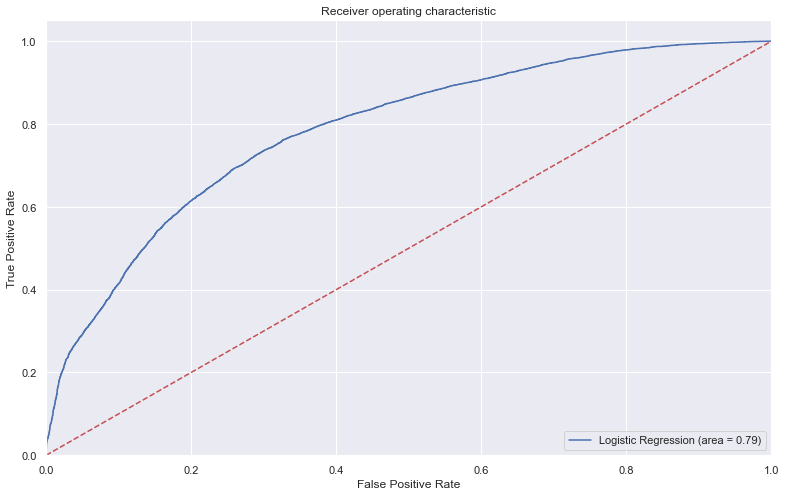

In [40]:
#AUC ROC curve
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve

logit_roc_auc = roc_auc_score(y_test, lg.predict(X_test))
fpr, tpr, thresholds = roc_curve(y_test, lg.predict(X_test))
plt.figure(figsize=(13,8))
plt.plot(fpr, tpr, label='Logistic Regression (area = %0.2f)' % logit_roc_auc)
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.savefig('Log_ROC')
plt.show()

In [41]:
##  Function to calculate different metric scores of the model - Accuracy, Recall and Precision
def get_metrics_score(model,flag=True):
    '''
    model : classifier to predict values of X

    '''
    # defining an empty list to store train and test results
    score_list=[] 
    
    pred_train = model.predict(X_train)
    pred_test = model.predict(X_test)
    
    train_acc = model.score(X_train,y_train)
    test_acc = model.score(X_test,y_test)
    
    train_recall = metrics.recall_score(y_train,pred_train)
    test_recall = metrics.recall_score(y_test,pred_test)
    
    train_precision = metrics.precision_score(y_train,pred_train)
    test_precision = metrics.precision_score(y_test,pred_test)
    
    score_list.extend((train_acc,test_acc,train_recall,test_recall,train_precision,test_precision))
        
    # If the flag is set to True then only the following print statements will be dispayed. The default value is set to True.
    if flag == True: 
        print("Accuracy on training set : ",model.score(X_train,y_train))
        print("Accuracy on test set : ",model.score(X_test,y_test))
        print("Recall on training set : ",metrics.recall_score(y_train,pred_train))
        print("Recall on test set : ",metrics.recall_score(y_test,pred_test))
        print("Precision on training set : ",metrics.precision_score(y_train,pred_train))
        print("Precision on test set : ",metrics.precision_score(y_test,pred_test))
    
    return score_list # returning the list with train and test scores

In [42]:
## Function to create confusion matrix
def make_confusion_matrix(model,y_actual,labels=[1, 0]):
    '''
    model : classifier to predict values of X
    y_actual : ground truth  
    
    '''
    y_predict = model.predict(X_test)
    cm=metrics.confusion_matrix( y_actual, y_predict, labels=[0, 1])
    df_cm = pd.DataFrame(cm, index = [i for i in ["Actual - No","Actual - Yes"]],
                  columns = [i for i in ['Predicted - No','Predicted - Yes']])
    group_counts = ["{0:0.0f}".format(value) for value in
                cm.flatten()]
    group_percentages = ["{0:.2%}".format(value) for value in
                         cm.flatten()/np.sum(cm)]
    labels = [f"{v1}\n{v2}" for v1, v2 in
              zip(group_counts,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)
    plt.figure(figsize = (10,7))
    sns.heatmap(df_cm, annot=labels,fmt='')
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

Decision trees

Accuracy on training set :  1.0
Accuracy on test set :  0.9023317201935768
Recall on training set :  1.0
Recall on test set :  0.9102994494427287
Precision on training set :  1.0
Precision on test set :  0.910788660486363


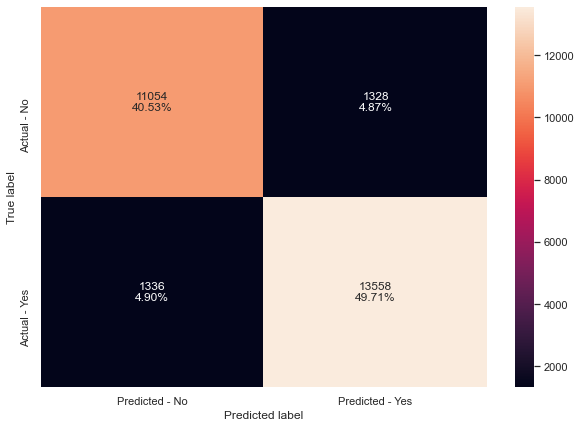

In [43]:
#Fitting the model
d_tree = DecisionTreeClassifier(random_state=1)
d_tree.fit(X_train,y_train)

#Calculating different metrics
get_metrics_score(d_tree)

#Creating confusion matrix
make_confusion_matrix(d_tree,y_test)

Pruning 

In [49]:
path = d_tree.cost_complexity_pruning_path(X_train, y_train)

ccp_alphas, impurities = path.ccp_alphas, path.impurities

In [84]:
clfs_list = []

for ccp_alpha in ccp_alphas:
    clf = DecisionTreeClassifier(random_state=1, ccp_alpha=ccp_alpha)
    clf.fit(X_train, y_train)
    clfs_list.append(clf)

print("Number of nodes in the last tree is: {} with ccp_alpha: {}".format(clfs_list[-1].tree_.node_count, ccp_alphas[-1]))

KeyboardInterrupt: 

Text(66.5, 0.5, 'Truth')

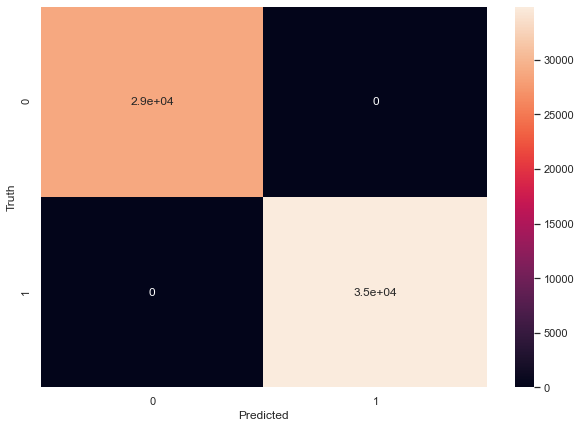

In [52]:
clfs_list = []

for ccp_alpha in ccp_alphas:
    clf = DecisionTreeClassifier(random_state=1, ccp_alpha=ccp_alpha)
    clf.fit(X_train, y_train)
    clfs_list.append(clf)

print("Number of nodes in the last tree is: {} with ccp_alpha: {}".format(clfs_list[-1].tree_.node_count, ccp_alphas[-1]))

In [53]:
#Fitting model for each value of alpha and saving the train recall in a list 
recall_train=[]
for clf in clfs_list:
    pred_train=clf.predict(X_train)
    values_train=metrics.recall_score(y_train,pred_train)
    recall_train.append(values_train)

array([[11054,  1328],
       [ 1336, 13558]], dtype=int64)

In [61]:
#Fitting model for each value of alpha and saving the test recall in a list
recall_test=[]
for clf in clfs_list:
    pred_test=clf.predict(X_test)
    values_test=metrics.recall_score(y_test,pred_test)
    recall_test.append(values_test)

DecisionTreeRegressor(random_state=1)

In [62]:
#Plotting the graph for Recall VS alpha 
fig, ax = plt.subplots(figsize=(15,5))
ax.set_xlabel("alpha")
ax.set_ylabel("Recall")
ax.set_title("Recall vs alpha for training and testing sets")
ax.plot(ccp_alphas, recall_train, marker='o', label="train",
        drawstyle="steps-post")
ax.plot(ccp_alphas, recall_test, marker='o', label="test",
        drawstyle="steps-post")
ax.legend()
plt.show()

R-sqaure on training set :  1.0
R-square on test set :  0.6154508280200814
RMSE on training set :  0.0
RMSE on test set :  0.30874244072684376


In [ ]:
#Creating the model where we get highest test recall
index_best_pruned_model = np.argmax(recall_test)

pruned_dtree_model = clfs_list[index_best_pruned_model]

get_metrics_score(pruned_dtree_model)

make_confusion_matrix(pruned_dtree_model,y_test)

Hyper parameter tuning 

In [77]:
#Choose the type of classifier. 
dtree_estimator = DecisionTreeClassifier(class_weight={0:0.18,1:0.72},random_state=1)

# Grid of parameters to choose from
parameters = {'max_depth': np.arange(2,30), 
              'min_samples_leaf': [1, 2, 5, 7, 10],
              'max_leaf_nodes' : [2, 3, 5, 10,15],
              'min_impurity_decrease': [0.0001,0.001,0.01,0.1]
             }

# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(metrics.recall_score)

# Run the grid search
grid_obj = GridSearchCV(dtree_estimator, parameters, scoring=scorer,n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
dtree_estimator = grid_obj.best_estimator_

# Fit the best algorithm to the data. 
dtree_estimator.fit(X_train, y_train)

KeyboardInterrupt: 

In [65]:
get_metrics_score(dtree_estimator)

make_confusion_matrix(dtree_estimator,y_test)

R-sqaure on training set :  0.8023254951133686
R-square on test set :  0.7499350818289602
RMSE on training set :  0.22128182531446441
RMSE on test set :  0.2489698611160051


In [66]:
# importance of features in the tree building ( The importance of a feature is computed as the 
#(normalized) total reduction of the criterion brought by that feature. It is also known as the Gini importance )

print(pd.DataFrame(dtree_tuned.feature_importances_, columns = ["Imp"], index = X_train.columns).sort_values(by = 'Imp', ascending = False))

                                Imp
Inflight_entertainment         0.52
Seat_comfort                   0.19
Gate_location                  0.04
Class                          0.04
Cleanliness                    0.03
Checkin_service                0.03
Baggage_handling               0.03
Flight_Distance_log            0.02
Age                            0.02
CustomerType_disloyal Customer 0.02
Leg_room_service               0.02
Inflightwifi_service           0.02
Onboard_service_excellent      0.01
ArrivalDelayin_Mins_log        0.01
DepartureDelayin_Mins_log      0.01
Food_drink_excellent           0.00
Onboard_service_poor           0.00


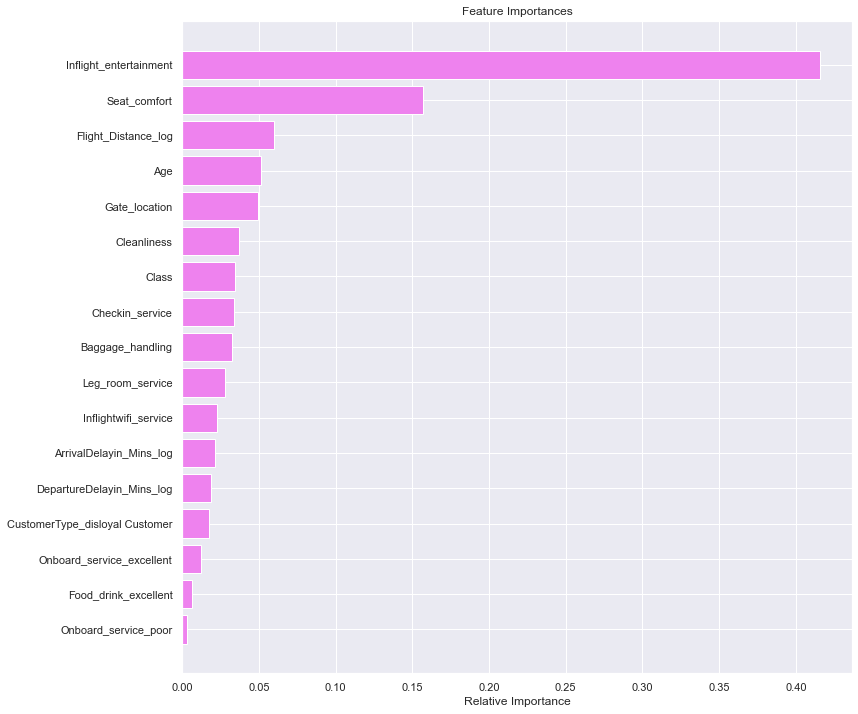

In [68]:
feature_names = X_train.columns
importances = d_tree.feature_importances_
indices = np.argsort(importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='violet', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

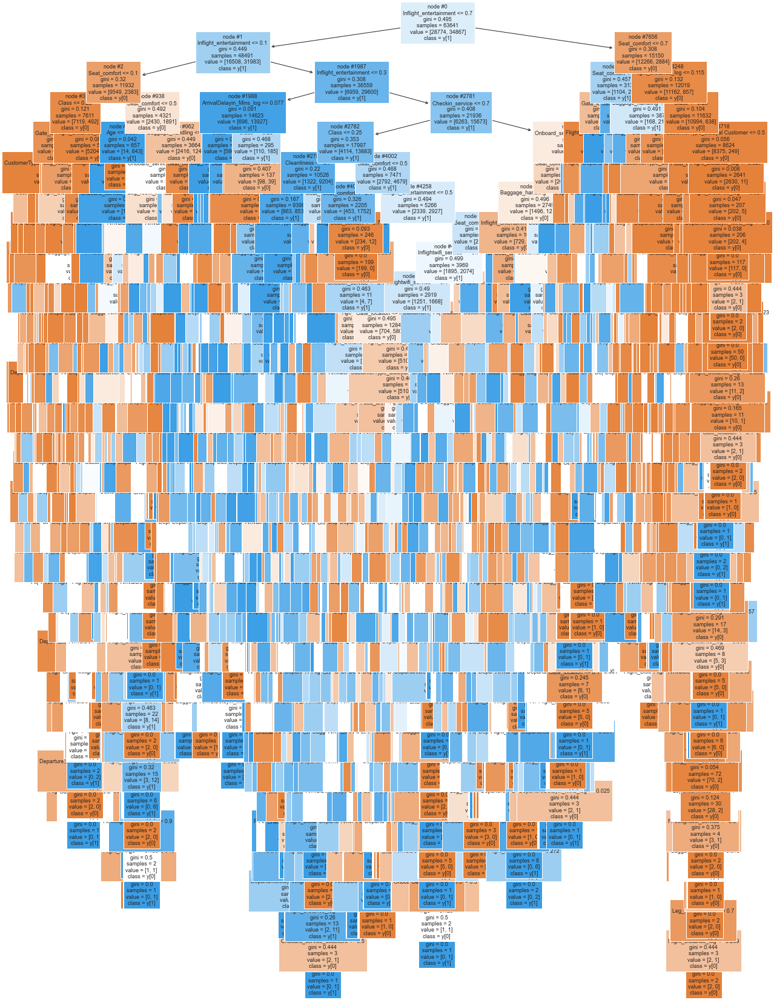

In [74]:
from sklearn import tree
plt.figure(figsize=(20,30))
tree.plot_tree(d_tree,feature_names=feature_names,filled=True,fontsize=9,node_ids=True,class_names=True)
plt.show()

In [75]:
# Text report showing the rules of a decision tree -

print(tree.export_text(d_tree,feature_names=feature_names,show_weights=True))

ValueError: The truth value of a Index is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().

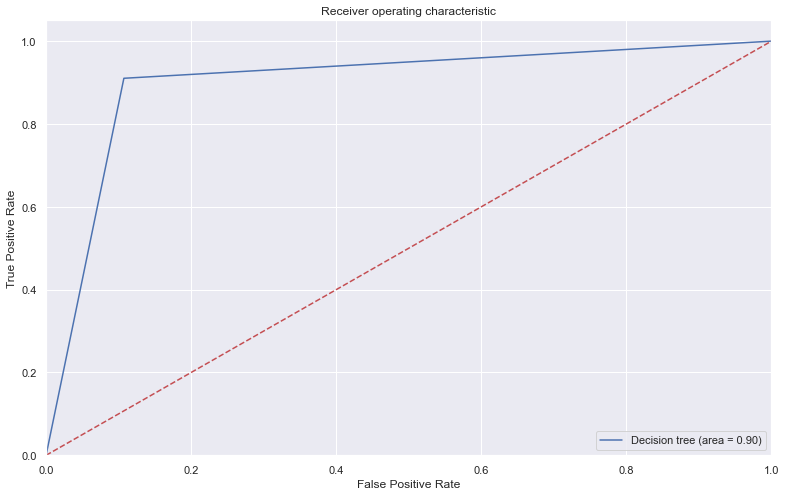

In [44]:
#AUC ROC curve
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve

logit_roc_auc = roc_auc_score(y_test, d_tree.predict_proba(X_test)[:,1])
fpr, tpr, thresholds = roc_curve(y_test, d_tree.predict_proba(X_test)[:,1])
plt.figure(figsize=(13,8))
plt.plot(fpr, tpr, label='Decision tree (area = %0.2f)' % logit_roc_auc)
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.savefig('Log_ROC')
plt.show()

Random Forest 

<ipython-input-45-adac65675d7c>:3: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  rf_estimator.fit(X_train,y_train)


Accuracy on training set :  1.0
Accuracy on test set :  0.9351077870655521
Recall on training set :  1.0
Recall on test set :  0.9342016919564925
Precision on training set :  1.0
Precision on test set :  0.9462731229597389


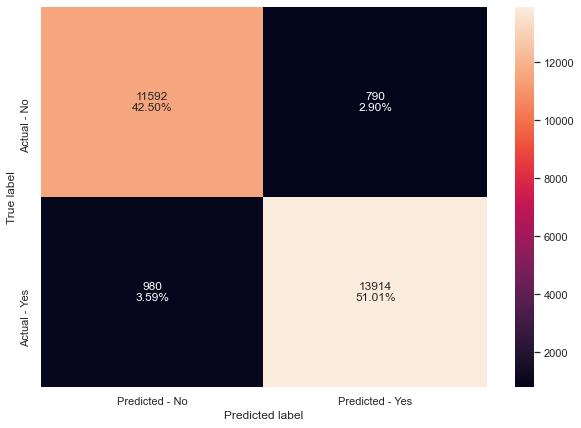

In [45]:
#Fitting the model
rf_estimator = RandomForestClassifier(random_state=1)
rf_estimator.fit(X_train,y_train)

#Calculating different metrics
get_metrics_score(rf_estimator)

#Creating confusion matrix
make_confusion_matrix(rf_estimator,y_test)

AttributeError: 'RandomForestClassifier' object has no attribute 'summary'

In [81]:
# Let's check accuracy and recall for this model

from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score

rf_pred_train = rf_estimator.predict(X_train)
rf_pred_test = rf_estimator.predict(X_test)

rf_pred_train1 = np.round(rf_pred_train)
rf_pred_test1 = np.round(rf_pred_test)

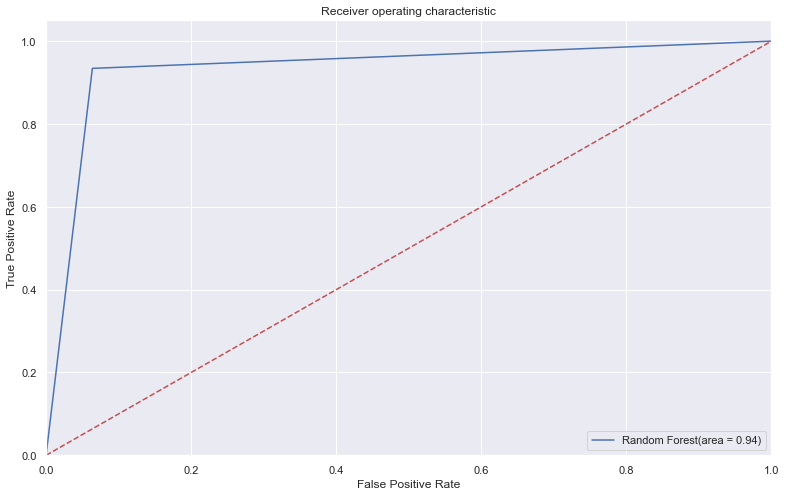

In [84]:
#AUC ROC curve
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve

logit_roc_auc = roc_auc_score(y_test, rf_estimator.predict(X_test))
fpr, tpr, thresholds = roc_curve(y_test, rf_estimator.predict(X_test))
plt.figure(figsize=(13,8))
plt.plot(fpr, tpr, label='Random Forest(area = %0.2f)' % logit_roc_auc)
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.savefig('rf_ROC')
plt.show()

Hyper parameter 

In [40]:
# Choose the type of classifier. 
rf_tuned = RandomForestClassifier(class_weight={0:0.18,1:0.82},random_state=1,oob_score=True,bootstrap=True)

parameters = {  
                'max_depth': list(np.arange(5,30,5)) + [None],
                'max_features': ['sqrt','log2',None],
                'min_samples_leaf': np.arange(1,15,5),
                'min_samples_split': np.arange(2, 20, 5),
                'n_estimators': np.arange(10,110,10)}


# Run the grid search
grid_obj = GridSearchCV(rf_tuned, parameters, scoring='recall',cv=5,n_jobs=-1)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
rf_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data. 
rf_tuned.fit(X_train, y_train)

KeyboardInterrupt: 

In [63]:
#Calculating different metrics
get_metrics_score(rf_tuned)

#Creating confusion matrix
make_confusion_matrix(rf_tuned,y_test)

R-sqaure on training set :  0.9718165595886186
R-square on test set :  0.7988029488230586
RMSE on training set :  0.0835540333149128
RMSE on test set :  0.22332184051125128


In [42]:
# importance of features in the tree building ( The importance of a feature is computed as the 
#(normalized) total reduction of the criterion brought by that feature. It is also known as the Gini importance )

print(pd.DataFrame(rf_estimator.feature_importances_, columns = ["Imp"], index = X_train.columns).sort_values(by = 'Imp', ascending = False))

                                     Imp
Inflight_entertainment          0.242391
Seat_comfort                    0.163671
Class                           0.069499
Flight_Distance_log             0.069405
Age                             0.057868
Leg_room_service                0.057200
Gate_location                   0.047615
Checkin_service                 0.045236
Baggage_handling                0.041232
CustomerType_disloyal Customer  0.040654
Cleanliness                     0.039873
Inflightwifi_service            0.034481
ArrivalDelayin_Mins_log         0.026031
DepartureDelayin_Mins_log       0.023925
Onboard_service_excellent       0.018560
Food_drink_excellent            0.015585
Onboard_service_poor            0.006774


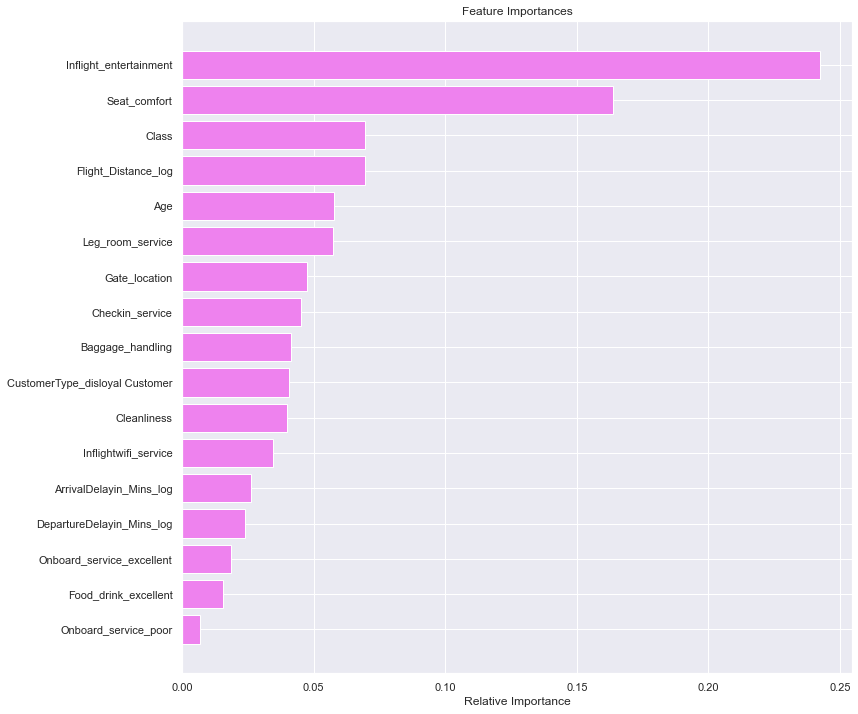

In [43]:
feature_names = X_train.columns
importances = rf_estimator.feature_importances_
indices_rf = np.argsort(importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(indices_rf)), importances[indices_rf], color='violet', align='center')
plt.yticks(range(len(indices_rf)), [feature_names[i] for i in indices_rf])
plt.xlabel('Relative Importance')
plt.show()

Gradient Boosting Classifier 

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


Accuracy on training set :  0.9949246554893858
Accuracy on test set :  0.9240357823727819
Recall on training set :  0.9927151748071242
Recall on test set :  0.9122465422317712
Precision on training set :  0.9980104953578225
Precision on test set :  0.9466973244147158


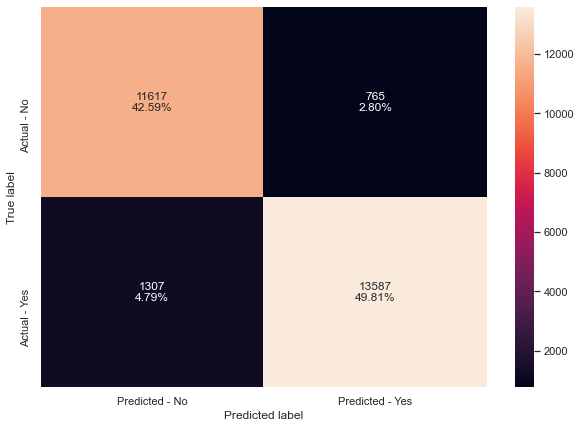

In [46]:
#Fitting the model
bagging_classifier = BaggingClassifier(random_state=1)
bagging_classifier.fit(X_train,y_train)

#Calculating different metrics
get_metrics_score(bagging_classifier)

#Creating confusion matrix
make_confusion_matrix(bagging_classifier,y_test)

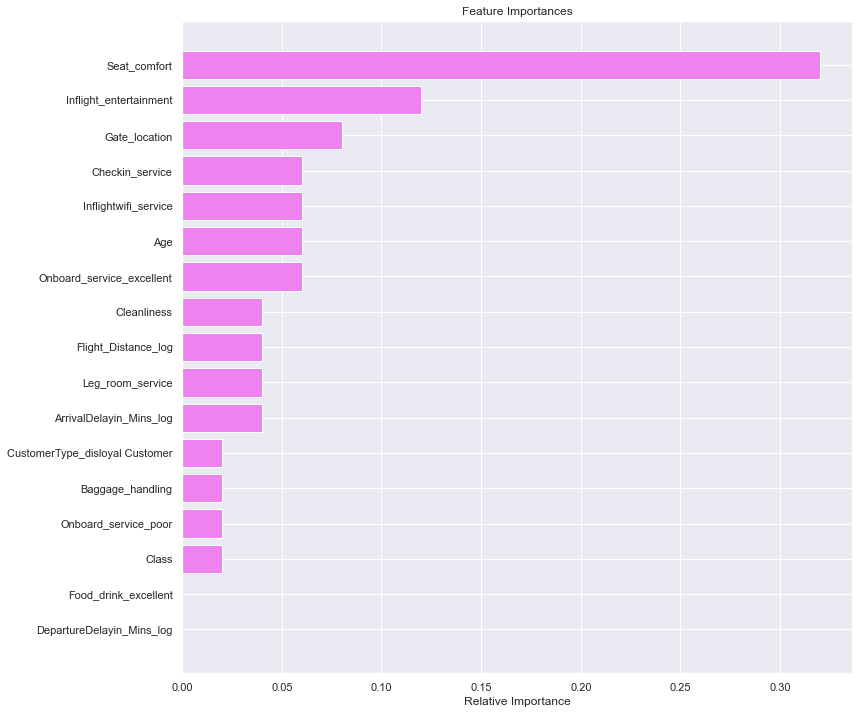

In [69]:
ab_feature_names = X_train.columns
ab_importances =ab_classifier.feature_importances_
ab_indices = np.argsort(ab_importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(ab_indices)), ab_importances[ab_indices], color='violet', align='center')
plt.yticks(range(len(ab_indices)), [ab_feature_names[i] for i in ab_indices])
plt.xlabel('Relative Importance')
plt.show()

In [71]:
# Choose the type of classifier. 
bagging_estimator_tuned = BaggingClassifier(random_state=1)

# Grid of parameters to choose from
parameters = {'max_samples': [0.7,0.8,0.9,1], 
              'max_features': [0.7,0.8,0.9,1],
              'n_estimators' : [10,20,30,40,50],
             }

# Type of scoring used to compare parameter combinations
acc_scorer = metrics.make_scorer(metrics.recall_score)

# Run the grid search
grid_obj = GridSearchCV(bagging_estimator_tuned, parameters, scoring=acc_scorer,cv=5)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
bagging_estimator_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
bagging_estimator_tuned.fit(X_train, y_train)

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

KeyboardInterrupt: 

In [ ]:
#Calculating different metrics
get_metrics_score(bagging_estimator_tuned)

#Creating confusion matrix
make_confusion_matrix(bagging_estimator_tuned,y_test)

In [85]:
# importance of features in the tree building ( The importance of a feature is computed as the 
#(normalized) total reduction of the criterion brought by that feature. It is also known as the Gini importance )

print(pd.DataFrame(bagging_classifier.feature_importances_, columns = ["Imp"], index = X_train.columns).sort_values(by = 'Imp', ascending = False))

AttributeError: 'BaggingClassifier' object has no attribute 'feature_importances_'

 Adaboosting

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


Accuracy on training set :  0.8780974528998602
Accuracy on test set :  0.8764481595541869
Recall on training set :  0.8876301373791837
Recall on test set :  0.8863300657983081
Precision on training set :  0.8896202822731323
Precision on test set :  0.8872832369942196


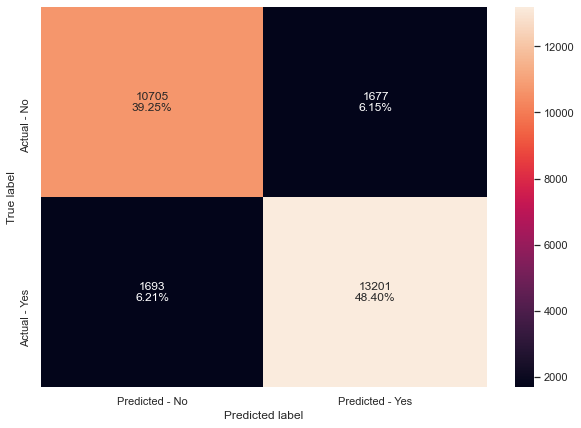

In [47]:
#Fitting the model
ab_classifier = AdaBoostClassifier(random_state=1)
ab_classifier.fit(X_train,y_train)

#Calculating different metrics
get_metrics_score(ab_classifier)

#Creating confusion matrix
make_confusion_matrix(ab_classifier,y_test)

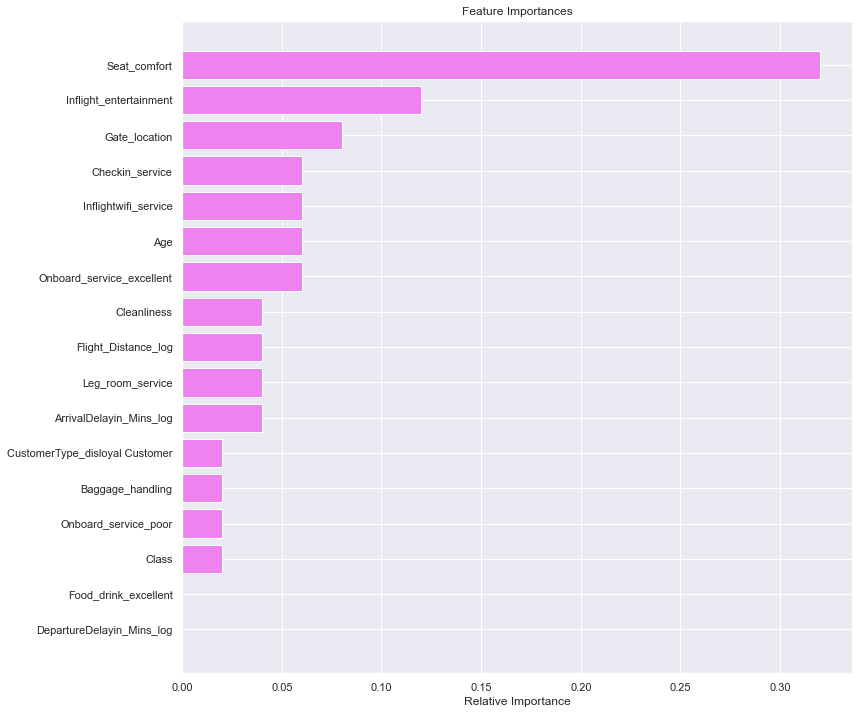

In [68]:
ab_feature_names = X_train.columns
ab_importances =ab_classifier.feature_importances_
ab_indices = np.argsort(ab_importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(ab_indices)), ab_importances[ab_indices], color='violet', align='center')
plt.yticks(range(len(ab_indices)), [ab_feature_names[i] for i in ab_indices])
plt.xlabel('Relative Importance')
plt.show()

In [68]:
# Choose the type of classifier. 
abc_tuned = AdaBoostClassifier(random_state=1)

# Grid of parameters to choose from
parameters = {
    #Let's try different max_depth for base_estimator
    "base_estimator":[DecisionTreeClassifier(max_depth=1),DecisionTreeClassifier(max_depth=2),
                      DecisionTreeClassifier(max_depth=3)],
    "n_estimators": np.arange(10,110,10),
    "learning_rate":np.arange(0.1,2,0.1)
}

# Type of scoring used to compare parameter  combinations
acc_scorer = metrics.make_scorer(metrics.recall_score)

# Run the grid search
grid_obj = GridSearchCV(abc_tuned, parameters, scoring=acc_scorer,cv=5)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
abc_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
abc_tuned.fit(X_train, y_train)

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example

KeyboardInterrupt: 

In [ ]:
#Calculating different metrics
get_metrics_score(abc_tuned)

#Creating confusion matrix
make_confusion_matrix(abc_tuned,y_test)

Gradient Boosting

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


Accuracy on training set :  0.9052183340928018
Accuracy on test set :  0.9034682504766095
Recall on training set :  0.9226202426363037
Recall on test set :  0.920303477910568
Precision on training set :  0.90609244289215
Precision on test set :  0.9045733518115224


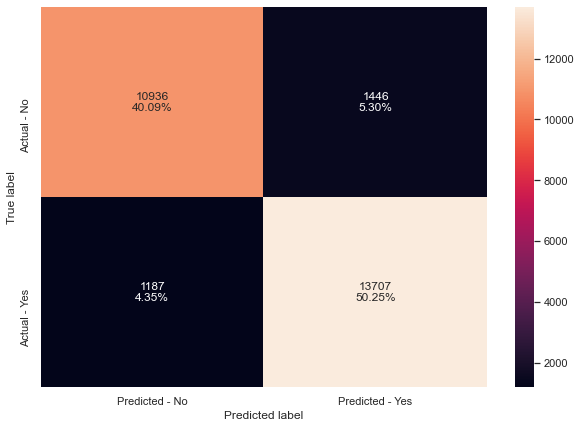

In [48]:
#Fitting the model
gb_classifier = GradientBoostingClassifier(random_state=1)
gb_classifier.fit(X_train,y_train)

#Calculating different metrics
get_metrics_score(gb_classifier)

#Creating confusion matrix
make_confusion_matrix(gb_classifier,y_test)

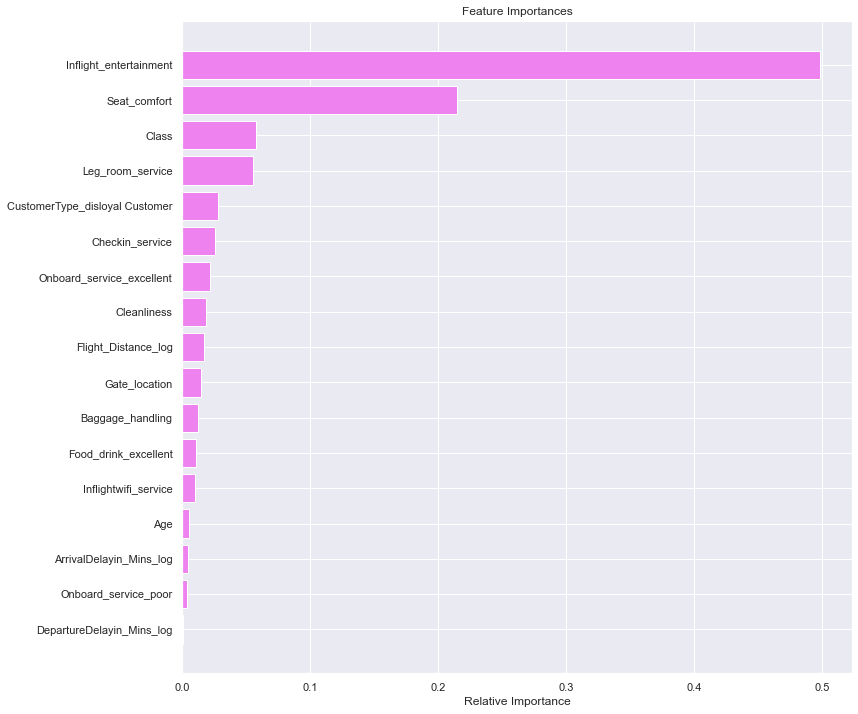

In [67]:
gb_feature_names = X_train.columns
gb_importances =gb_classifier.feature_importances_
gb_indices = np.argsort(gb_importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(gb_indices)), gb_importances[gb_indices], color='violet', align='center')
plt.yticks(range(len(gb_indices)), [gb_feature_names[i] for i in gb_indices])
plt.xlabel('Relative Importance')
plt.show()

In [ ]:
# Choose the type of classifier. 
gbc_tuned = GradientBoostingClassifier(init=AdaBoostClassifier(random_state=1),random_state=1)

# Grid of parameters to choose from
parameters = {
    "n_estimators": [100,150,200,250],
    "subsample":[0.8,0.9,1],
    "max_features":[0.7,0.8,0.9,1]
}

# Type of scoring used to compare parameter combinations
acc_scorer = metrics.make_scorer(metrics.recall_score)

# Run the grid search
grid_obj = GridSearchCV(gbc_tuned, parameters, scoring=acc_scorer,cv=5)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
gbc_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
gbc_tuned.fit(X_train, y_train)

In [ ]:
#Calculating different metrics
get_metrics_score(gbc_tuned)

#Creating confusion matrix
make_confusion_matrix(gbc_tuned,y_test)

Xgboost 

C:\Users\Osilade\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


[21:29:31] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Accuracy on training set :  0.9582501846294056
Accuracy on test set :  0.9365009532189471
Recall on training set :  0.9592164510855536
Recall on test set :  0.9379615952732644
Precision on training set :  0.9643886966551326
Precision on test set :  0.9453241304642035


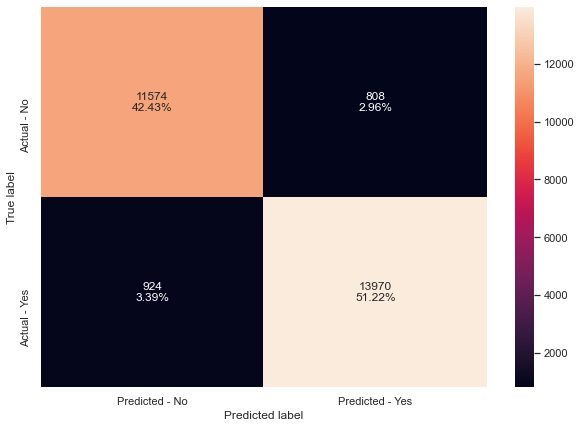

In [49]:
#Fitting the model
xgb_classifier = XGBClassifier(random_state=1)
xgb_classifier.fit(X_train,y_train)

#Calculating different metrics
get_metrics_score(xgb_classifier)

#Creating confusion matrix
make_confusion_matrix(xgb_classifier,y_test)

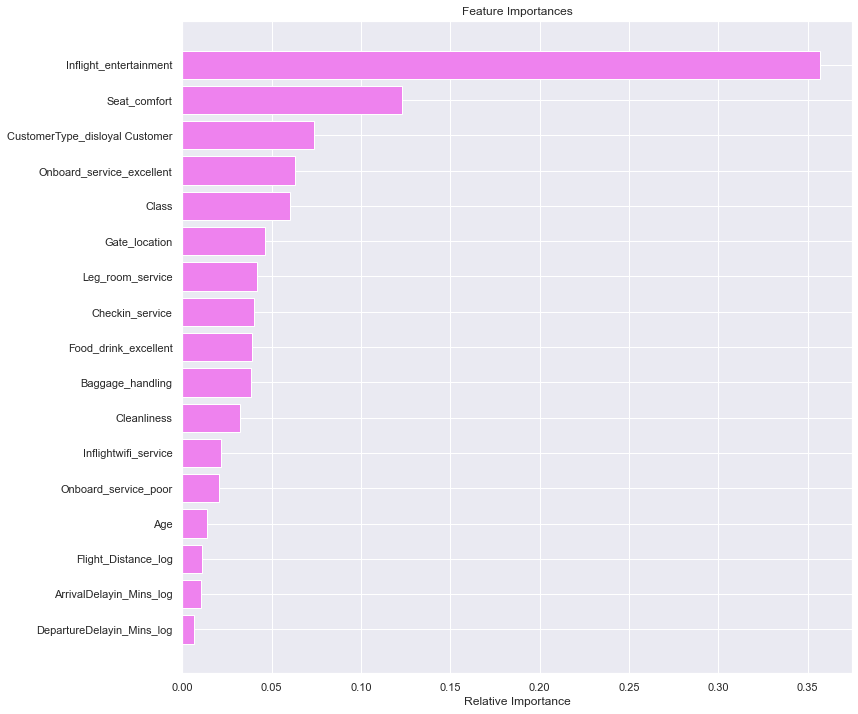

In [66]:
xgb_feature_names = X_train.columns
xgb_importances =xgb_classifier.feature_importances_
xgb_indices = np.argsort(xgb_importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(xgb_indices)), xgb_importances[xgb_indices], color='violet', align='center')
plt.yticks(range(len(xgb_indices)), [xgb_feature_names[i] for i in xgb_indices])
plt.xlabel('Relative Importance')
plt.show()

In [ ]:
# Choose the type of classifier. 
xgb_tuned = XGBClassifier(random_state=1)

# Grid of parameters to choose from
parameters = {
    "n_estimators": np.arange(10,100,20),
    "scale_pos_weight":[0,1,2,5],
    "subsample":[0.5,0.7,0.9,1],
    "learning_rate":[0.01,0.1,0.2,0.05],
    "gamma":[0,1,3],
    "colsample_bytree":[0.5,0.7,0.9,1],
    "colsample_bylevel":[0.5,0.7,0.9,1]
}

# Type of scoring used to compare parameter combinations
acc_scorer = metrics.make_scorer(metrics.recall_score)

# Run the grid search
grid_obj = GridSearchCV(xgb_tuned, parameters,scoring=acc_scorer,cv=5)
grid_obj = grid_obj.fit(X_train, y_train)

# Set the clf to the best combination of parameters
xgb_tuned = grid_obj.best_estimator_

# Fit the best algorithm to the data.
xgb_tuned.fit(X_train, y_train)

In [ ]:
#Calculating different metrics
get_metrics_score(xgb_tuned)

#Creating confusion matrix
make_confusion_matrix(xgb_tuned,y_test)

Stacking Classifier

In [50]:
estimators = [('Random Forest',rf_estimator), ('Gradient Boosting',xgb_classifier), ('Decision Tree',d_tree),('ada boost',ab_classifier )]

final_estimator = xgb_classifier

stacking_classifier= StackingClassifier(estimators=estimators,final_estimator=final_estimator)

stacking_classifier.fit(X_train,y_train)

C:\Users\Osilade\anaconda3\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)
C:\Users\Osilade\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[21:32:06] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\Osilade\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[21:36:37] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\Osilade\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[21:37:09] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\Osilade\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[21:37:38] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\Osilade\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[21:38:09] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\Osilade\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[21:38:36] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


C:\Users\Osilade\anaconda3\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[21:40:19] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


StackingClassifier(estimators=[('Random Forest',
                                RandomForestClassifier(random_state=1)),
                               ('Gradient Boosting',
                                XGBClassifier(base_score=0.5, booster='gbtree',
                                              colsample_bylevel=1,
                                              colsample_bynode=1,
                                              colsample_bytree=1, gamma=0,
                                              gpu_id=-1, importance_type='gain',
                                              interaction_constraints='',
                                              learning_rate=0.300000012,
                                              max_delta_step=0, max_depth=6,
                                              min_child_weight...
                                                 colsample_bytree=1, gamma=0,
                                                 gpu_id=-1,
                            

Accuracy on training set :  0.983139799814585
Accuracy on test set :  0.9373075230972283
Recall on training set :  0.9800097513408094
Recall on test set :  0.9306432120316906
Precision on training set :  0.9891159613269264
Precision on test set :  0.9534323840968496


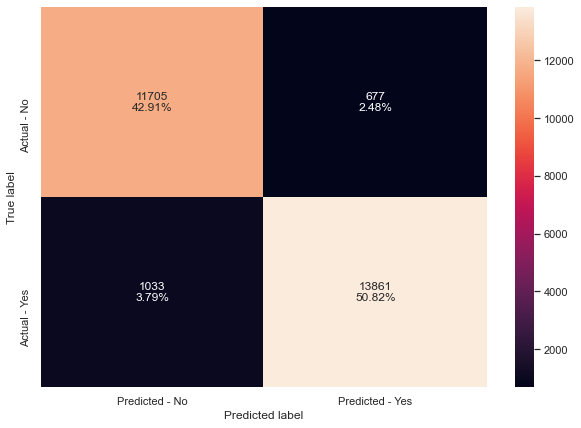

In [56]:
#Calculating different metrics
get_metrics_score(stacking_classifier)

#Creating confusion matrix
make_confusion_matrix(stacking_classifier,y_test)

In [76]:
sk_feature_names = X_train.columns
sk_importances =sk_classifier.feature_importances_
sk_indices = np.argsort(sk_importances)

plt.figure(figsize=(12,12))
plt.title('Feature Importances')
plt.barh(range(len(sk_indices)), sk_importances[xgb_indices], color='violet', align='center')
plt.yticks(range(len(sk_indices)), [sk_feature_names[i] for i in xgb_indices])
plt.xlabel('Relative Importance')
plt.show()

NameError: name 'sk_classifier' is not defined

Model Comparison 

In [55]:
# defining list of models
models = [d_tree,rf_estimator, bagging_classifier,ab_classifier,
           gb_classifier, xgb_classifier,stacking_classifier]

# defining empty lists to add train and test results
acc_train = []
acc_test = []
recall_train = []
recall_test = []
precision_train = []
precision_test = []

# looping through all the models to get the metrics score - Accuracy, Recall and Precision
for model in models:
    
    j = get_metrics_score(model,False)
    acc_train.append(j[0])
    acc_test.append(j[1])
    recall_train.append(j[2])
    recall_test.append(j[3])
    precision_train.append(j[4])
    precision_test.append(j[5])

In [61]:
comparison_frame = pd.DataFrame({'Model':['d_tree','rf_estimator',
                                          'bagging_classifier','ab_classifier',
                                          'gb_classifier',
                                          'xgb_classifier', 'stacking_classifier']
                                 Train_Accuracy': acc_train,'Test_Accuracy': acc_test,
                                          'Train_Recall':recall_train,'Test_Recall':recall_test,
                                          'Train_Precision':precision_train,'Test_Precision':precision_test}) 
                                          

#Sorting models in decreasing order of test recall
comparison_frame.sort_values(by='Test_Recall',ascending=False)

SyntaxError: invalid syntax (<ipython-input-61-d4d6f1c8e77c>, line 5)

In [62]:
comparison_frame = pd.DataFrame({'Model':['Decision Tree','Random Forest',
                                          'Bagging Classifier','AdaBoost Classifier',
                                          'Gradient Boosting Classifier',
                                          'XGBoost Classifier', 'Stacking Classifier'], 
                                          'Train_Accuracy': acc_train,'Test_Accuracy': acc_test,
                                          'Train_Recall':recall_train,'Test_Recall':recall_test,
                                          'Train_Precision':precision_train,'Test_Precision':precision_test}) 

#Sorting models in decreasing order of test recall
comparison_frame.sort_values(by='Test_Recall',ascending=False)

,Model,Train_Accuracy,Test_Accuracy,Train_Recall,Test_Recall,Train_Precision,Test_Precision
5,XGBoost Classifier,0.958250,0.936501,0.959216,0.937962,0.964389,0.945324
1,Random Forest,1.000000,0.935108,1.000000,0.934202,1.000000,0.946273
6,Stacking Classifier,0.987037,0.938297,0.987352,0.932657,0.988969,0.953332
4,Gradient Boosting Classifier,0.905218,0.903468,0.922620,0.920303,0.906092,0.904573
2,Bagging Classifier,0.994925,0.924036,0.992715,0.912247,0.998010,0.946697
0,Decision Tree,1.000000,0.902332,1.000000,0.910299,1.000000,0.910789
3,AdaBoost Classifier,0.878097,0.876448,0.887630,0.886330,0.889620,0.887283
